Selected neural columns: ['dF_F_roi0', 'dF_F_roi1', 'dF_F_roi2', 'dF_F_roi3', 'dF_F_roi4', 'dF_F_roi5', 'dF_F_roi6', 'dF_F_roi7', 'dF_F_roi8', 'dF_F_roi9', 'dF_F_roi10', 'dF_F_roi11', 'dF_F_roi12', 'dF_F_roi13', 'dF_F_roi14', 'dF_F_roi15', 'dF_F_roi16', 'dF_F_roi17', 'dF_F_roi18', 'dF_F_roi19', 'dF_F_roi20', 'dF_F_roi21', 'dF_F_roi22', 'dF_F_roi23', 'dF_F_roi24', 'dF_F_roi25', 'dF_F_roi26', 'dF_F_roi27', 'dF_F_roi28', 'dF_F_roi29', 'dF_F_roi30', 'dF_F_roi31', 'dF_F_roi32', 'dF_F_roi33', 'dF_F_roi34', 'dF_F_roi35', 'dF_F_roi36', 'dF_F_roi37', 'dF_F_roi38', 'dF_F_roi39', 'dF_F_roi40', 'dF_F_roi41', 'dF_F_roi42', 'dF_F_roi43', 'dF_F_roi44', 'dF_F_roi45', 'dF_F_roi46', 'dF_F_roi47', 'dF_F_roi48', 'dF_F_roi49', 'dF_F_roi50', 'dF_F_roi51', 'dF_F_roi52', 'dF_F_roi53', 'dF_F_roi54', 'dF_F_roi55', 'dF_F_roi56', 'dF_F_roi57', 'dF_F_roi58', 'dF_F_roi59', 'dF_F_roi60', 'dF_F_roi61', 'dF_F_roi62', 'dF_F_roi63', 'dF_F_roi64', 'dF_F_roi65', 'dF_F_roi66', 'dF_F_roi67', 'dF_F_roi68', 'dF_F_roi69', 'dF_

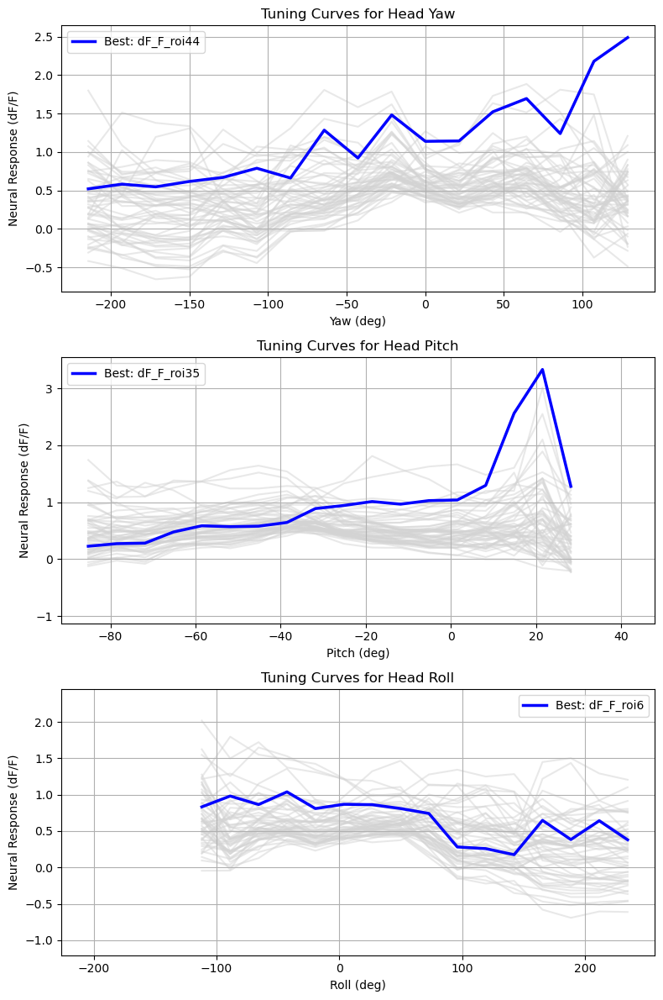

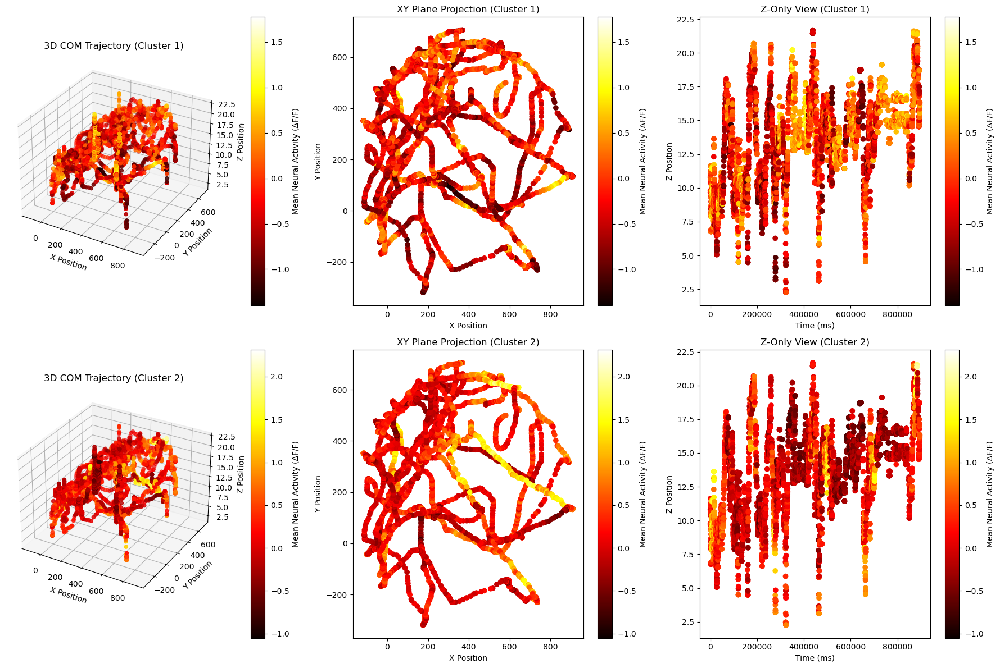

In [14]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.transform import Rotation as R
import matplotlib.cm as cm

# -----------------------------------
# 1. Load Data and Compute Angles
# -----------------------------------

# Adjust the path as needed.
hdf5_file_path = "/data/big_rim/rsync_dcc_sum/Oct3V1/2024_10_25/20241002PMCr2_17_05/MIR_Aligned/aligned_predictions_with_ca_and_dF_F.h5"
df = pd.read_hdf(hdf5_file_path, key='df')

# Define keypoint labels (1-indexed)
keypoint_labels = [
    'EarL',       # 1
    'EarR',       # 2
    'Snout',      # 3
    'SpineF',     # 4
    'SpineM',     # 5
    'Tail(base)', # 6
    'Tail(mid)',  # 7
    'Tail(end)',  # 8
    'ForepawL',   # 9
    'WristL',     # 10
    'ElbowL',     # 11
    'ShoulderL',  # 12
    'ForepawR',   # 13
    'WristR',     # 14
    'ElbowR',     # 15
    'ShoulderR',  # 16
    'HindpawL',   # 17
    'AnkleL',     # 18
    'KneeL',      # 19
    'HindpawR',   # 20
    'AnkleR',     # 21
    'KneeR'       # 22
]

def normalize(v):
    norm = np.linalg.norm(v)
    if norm < 1e-8:
        return v
    return v / norm

def compute_euler_angles_from_row(row):
    """Compute head Euler angles (relative to body) from a single DataFrame row."""
    # Helper to get a keypoint vector (using 1-indexing)
    def get_kp(idx):
        return np.array([row[f'kp{idx}_x'], row[f'kp{idx}_y'], row[f'kp{idx}_z']])
    
    # --- Head coordinate frame (using EarL (1), EarR (2), Snout (3)) ---
    earL = get_kp(1)
    earR = get_kp(2)
    snout = get_kp(3)
    ear_mid = (earL + earR) / 2.0
    head_x = normalize(snout - ear_mid)
    temp_y = earR - earL
    head_y = normalize(temp_y - np.dot(temp_y, head_x) * head_x)
    head_z = normalize(np.cross(head_x, head_y))
    
    # --- Body coordinate frame (using SpineF (4), SpineM (5), ShoulderL (12), ShoulderR (16)) ---
    spineF = get_kp(4)
    spineM = get_kp(5)
    shoulderL = get_kp(12)
    shoulderR = get_kp(16)
    body_x = normalize(spineF - spineM)
    shoulder_vec = shoulderR - shoulderL
    body_y = normalize(shoulder_vec - np.dot(shoulder_vec, body_x) * body_x)
    body_z = normalize(np.cross(body_x, body_y))
    
    # Construct rotation matrices and compute relative rotation (body -> head)
    R_body = np.column_stack((body_x, body_y, body_z))
    R_head = np.column_stack((head_x, head_y, head_z))
    R_rel = np.dot(R_body.T, R_head)
    
    # Convert to Euler angles (yaw, pitch, roll) in degrees
    euler_angles = R.from_matrix(R_rel).as_euler('xyz', degrees=True)
    return euler_angles  # [Yaw, Pitch, Roll]

# Precompute Euler angles for all frames.
nframes = len(df)
yaw_vals   = np.empty(nframes)
pitch_vals = np.empty(nframes)
roll_vals  = np.empty(nframes)
for i in range(nframes):
    row = df.iloc[i]
    euler = compute_euler_angles_from_row(row)
    yaw_vals[i]   = euler[0]
    pitch_vals[i] = euler[1]
    roll_vals[i]  = euler[2]

yaw_vals = np.degrees(np.unwrap(np.radians(yaw_vals)))
pitch_vals = np.degrees(np.unwrap(np.radians(pitch_vals)))
roll_vals = np.degrees(np.unwrap(np.radians(roll_vals)))


# -----------------------------------
# 2. Select Neural Data Columns
# -----------------------------------

neural_columns = [col for col in df.columns if col.startswith('dF_F_roi')]
print("Selected neural columns:", neural_columns)

# -----------------------------------
# 3. Compute Tuning Curves
# -----------------------------------

def compute_tuning_curve(angle_vals, neural_vals, nbins=20):
    """
    Bin the angle values and compute the mean neural response within each bin.
    """
    bins = np.linspace(np.min(angle_vals), np.max(angle_vals), nbins + 1)
    bin_centers = (bins[:-1] + bins[1:]) / 2.0
    avg_response = np.zeros(nbins)
    for i in range(nbins):
        mask = (angle_vals >= bins[i]) & (angle_vals < bins[i+1])
        if np.any(mask):
            avg_response[i] = np.mean(neural_vals[mask])
        else:
            avg_response[i] = np.nan
    return bin_centers, avg_response



exclude_indices = [1,3,8,46,75,78,55,11,56, 18, 84, 10, 77, 76, 74, 7, 2, 9, 17, 10, 12, 14, 15, 16, 18, 19, 13, 17, 0, 20, 60, 63, 70, 79, ]  # List of numbers you want to exclude

# ------------------------
# 1. Detect Outlier Neurons
# ------------------------

# 1. Calculate the maximum dF/F for each neuron
neuron_max_vals = {neuron: df[neuron].max() for neuron in neural_columns}

# 2. Determine a threshold for outliers
max_array = np.array(list(neuron_max_vals.values()))
mean_max = np.mean(max_array)
std_max = np.std(max_array)

threshold = mean_max + 3 * std_max  # 3-sigma threshold
print("Max threshold for outlier detection:", threshold)

# 3. Identify outlier neurons
outlier_neurons = [neuron for neuron, val in neuron_max_vals.items() if val > threshold]
print("Outlier neurons detected:", outlier_neurons)

# --- NEW: Manually specify neurons to exclude based on additional sanity checks ---
# exclude_indices = [84, 10, 77]  # List of numbers you want to exclude
manual_excluded_neurons = [f'dF_F_roi{i}' for i in exclude_indices]

# 4. Remove outliers and manually excluded neurons from the neural_columns list
clean_neural_columns = [
    neuron for neuron in neural_columns 
    if (neuron not in outlier_neurons and neuron not in manual_excluded_neurons)
]
print("Neurons kept after outlier and manual exclusion:", clean_neural_columns)

# ------------------------
# 2. Compute and Select Best Neuron for Plotting
# ------------------------

def compute_tuning_curve(angle_vals, neural_vals, nbins=20):
    """
    Bin the angle values and compute the mean neural response within each bin.
    """
    bins = np.linspace(np.min(angle_vals), np.max(angle_vals), nbins + 1)
    bin_centers = (bins[:-1] + bins[1:]) / 2.0
    avg_response = np.zeros(nbins)
    for i in range(nbins):
        mask = (angle_vals >= bins[i]) & (angle_vals < bins[i + 1])
        if np.any(mask):
            avg_response[i] = np.mean(neural_vals[mask])
        else:
            avg_response[i] = np.nan
    return bin_centers, avg_response

# Select the best neuron for each angle using tuning curve variance
best_neuron = {}
for angle_name, angle_vals in zip(['Yaw', 'Pitch', 'Roll'], [yaw_vals, pitch_vals, roll_vals]):
    best_metric = -np.inf
    selected_neuron = None
    for neuron in clean_neural_columns:
        neural_vals = df[neuron].values
        centers, tuning = compute_tuning_curve(angle_vals, neural_vals)
        metric = np.nanvar(tuning)
        if metric > best_metric:
            best_metric = metric
            selected_neuron = neuron
    best_neuron[angle_name] = selected_neuron

print("Best neurons for each angle after excluding outliers and manual exclusions:", best_neuron)

# ------------------------
# 3. Plot Tuning Curves
# ------------------------

fig, axes = plt.subplots(3, 1, figsize=(8, 12), sharex=False)

angle_names = ['Yaw', 'Pitch', 'Roll']
angle_values_list = [yaw_vals, pitch_vals, roll_vals]

for ax, angle_name, angle_vals in zip(axes, angle_names, angle_values_list):
    # Plot all clean neurons in gray (background)
    for neuron in clean_neural_columns:
        neural_vals = df[neuron].values
        centers, tuning = compute_tuning_curve(angle_vals, neural_vals)
        ax.plot(centers, tuning, linestyle='-', color='lightgray', alpha=0.5, zorder=1)
    
    # Highlight the best neuron in color
    neuron = best_neuron[angle_name]
    neural_vals = df[neuron].values
    centers, tuning = compute_tuning_curve(angle_vals, neural_vals)
    ax.plot(centers, tuning, linestyle='-', color='blue', lw=2.5, label=f'Best: {neuron}', zorder=2)

    ax.set_title(f'Tuning Curves for Head {angle_name}')
    ax.set_xlabel(f'{angle_name} (deg)')
    ax.set_ylabel('Neural Response (dF/F)')
    ax.legend()
    ax.grid(True)

plt.tight_layout()
plt.show()

from scipy.cluster.hierarchy import linkage, dendrogram, leaves_list
from scipy.stats import zscore

df_new = df.copy()
df_new = df_new.reset_index()

time = df_new['timestamp_ms_mini']
neuron_activity = df_new[clean_neural_columns].values  # shape: (timepoints, neurons)

# Transpose to get shape: (neurons, timepoints)
neuron_activity = neuron_activity.T

# Step to drop low-variance neurons (reduce false positives)
neuron_variances = np.var(neuron_activity, axis=1)  # Variance for each neuron
threshold = np.percentile(neuron_variances, 5)      # Keep top 95% variance
high_variance_indices = neuron_variances > threshold  # Mask for neurons to keep

# Filter neuron activity and neuron column names
neuron_activity_filtered = neuron_activity[high_variance_indices, :]
filtered_neuron_columns = [col for i, col in enumerate(clean_neural_columns) if high_variance_indices[i]]


# Optional: Z-score normalization along each neuron's time course
neuron_activity_normalized = zscore(neuron_activity_filtered, axis=1)
# 'correlation' is often a good metric for neural activity, but you can try 'euclidean'.
# 'average' linkage is a common choice, but feel free to experiment (e.g., 'ward', 'complete').
# Perform hierarchical clustering on the filtered and normalized data
Z = linkage(neuron_activity_normalized, method='average', metric='correlation')


from scipy.cluster.hierarchy import fcluster
# df_new = df_new.reset_index()


# time = df_new['timestamp_ms_mini']
# Step 1: Assign neurons to clusters
num_clusters = 2
cluster_labels = fcluster(Z, t=num_clusters, criterion='maxclust')  # Cluster labels for neurons (1 or 2)

# Step 2: Compute mean activity for each cluster
cluster_means = []
for cluster_id in range(1, num_clusters + 1):
    # Select neurons in the current cluster
    cluster_neurons = neuron_activity_normalized[cluster_labels == cluster_id, :]
    # Compute mean activity across neurons in this cluster
    cluster_mean = cluster_neurons.mean(axis=0)
    cluster_means.append(cluster_mean)

# Convert to a NumPy array for easier indexing
cluster_means = np.array(cluster_means)

# Step 3: Create plots for each cluster
fig = plt.figure(figsize=(18, 12))

# Plot for each cluster
for cluster_id in range(num_clusters):
    row_offset = cluster_id * 3  # Offset for each cluster's row

    # 3D Scatter Plot
    ax1 = fig.add_subplot(2, 3, row_offset + 1, projection='3d')
    scatter = ax1.scatter(
        df_new['com_x'], df_new['com_y'], df_new['com_z'],
        c=cluster_means[cluster_id, :len(df_new['com_x'])],  # Cluster mean activity
        cmap='hot', marker='o'
    )
    ax1.set_title(f'3D COM Trajectory (Cluster {cluster_id + 1})')
    ax1.set_xlabel('X Position')
    ax1.set_ylabel('Y Position')
    ax1.set_zlabel('Z Position')
    fig.colorbar(scatter, ax=ax1, pad=0.1, label='Mean Neural Activity (ΔF/F)')

    # XY Plane Projection
    ax2 = fig.add_subplot(2, 3, row_offset + 2)
    scatter_xy = ax2.scatter(
        df_new['com_x'], df_new['com_y'],
        c=cluster_means[cluster_id, :len(df_new['com_x'])],  # Cluster mean activity
        cmap='hot', marker='o'
    )
    ax2.set_title(f'XY Plane Projection (Cluster {cluster_id + 1})')
    ax2.set_xlabel('X Position')
    ax2.set_ylabel('Y Position')
    fig.colorbar(scatter_xy, ax=ax2, label='Mean Neural Activity (ΔF/F)')

    # Z-Only View
    ax3 = fig.add_subplot(2, 3, row_offset + 3)
    scatter_z = ax3.scatter(
        time, df_new['com_z'],
        c=cluster_means[cluster_id, :len(df_new['com_z'])],  # Cluster mean activity
        cmap='hot', marker='o'
    )
    ax3.set_title(f'Z-Only View (Cluster {cluster_id + 1})')
    ax3.set_xlabel('Time (ms)')
    ax3.set_ylabel('Z Position')
    fig.colorbar(scatter_z, ax=ax3, label='Mean Neural Activity (ΔF/F)')

plt.tight_layout()
plt.show()




Processing session: session1


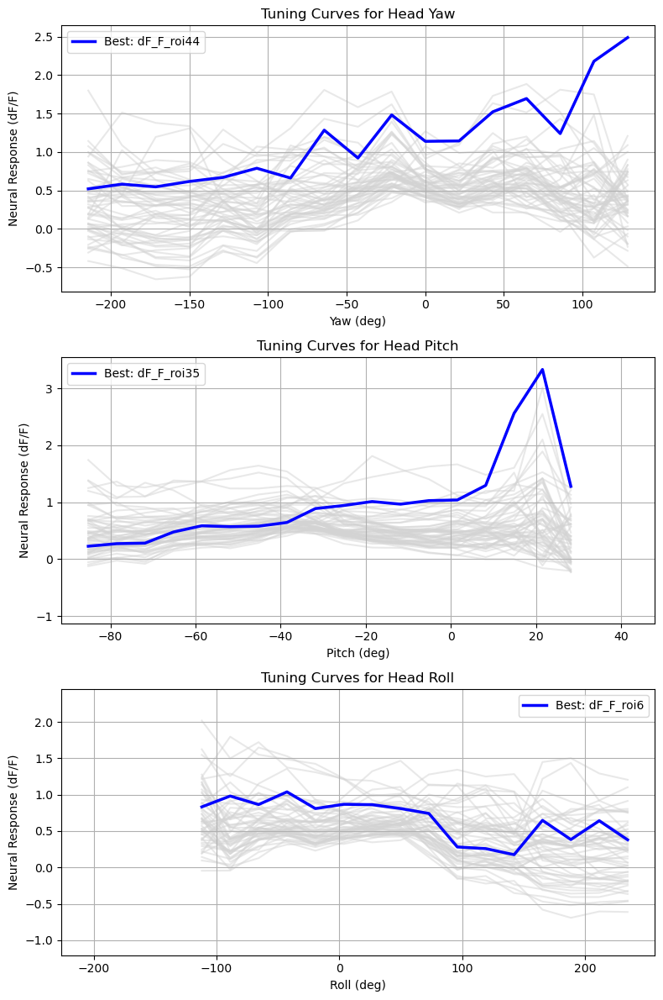

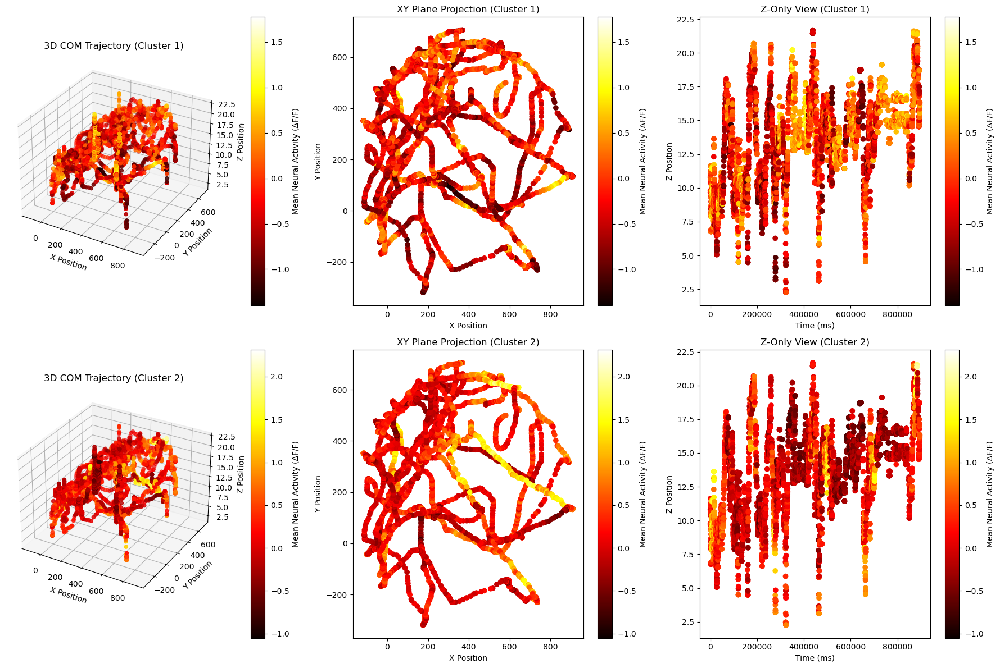

Session analysis completed.


In [15]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.transform import Rotation as R
from scipy.cluster.hierarchy import linkage, fcluster
from scipy.stats import zscore

# -----------------------------
# Utility Functions
# -----------------------------
def load_data(hdf5_file_path, session_id=None, location=None):
    """Load HDF5 file and attach optional metadata."""
    df = pd.read_hdf(hdf5_file_path, key='df')
    if session_id is not None:
        df['session_id'] = session_id
    if location is not None:
        df['location'] = location
    return df

def normalize(v):
    norm = np.linalg.norm(v)
    return v if norm < 1e-8 else v / norm

def compute_euler_angles_from_row(row):
    """Compute head Euler angles (relative to body) for one frame."""
    def get_kp(idx):
        return np.array([row[f'kp{idx}_x'], row[f'kp{idx}_y'], row[f'kp{idx}_z']])
    
    # Head coordinate frame (EarL=1, EarR=2, Snout=3)
    earL = get_kp(1)
    earR = get_kp(2)
    snout = get_kp(3)
    ear_mid = (earL + earR) / 2.0
    head_x = normalize(snout - ear_mid)
    temp_y = earR - earL
    head_y = normalize(temp_y - np.dot(temp_y, head_x) * head_x)
    head_z = normalize(np.cross(head_x, head_y))
    
    # Body coordinate frame (SpineF=4, SpineM=5, ShoulderL=12, ShoulderR=16)
    spineF = get_kp(4)
    spineM = get_kp(5)
    shoulderL = get_kp(12)
    shoulderR = get_kp(16)
    body_x = normalize(spineF - spineM)
    shoulder_vec = shoulderR - shoulderL
    body_y = normalize(shoulder_vec - np.dot(shoulder_vec, body_x) * body_x)
    body_z = normalize(np.cross(body_x, body_y))
    
    # Compute relative rotation from body to head.
    R_body = np.column_stack((body_x, body_y, body_z))
    R_head = np.column_stack((head_x, head_y, head_z))
    R_rel = np.dot(R_body.T, R_head)
    euler_angles = R.from_matrix(R_rel).as_euler('xyz', degrees=True)
    return euler_angles

def compute_all_euler_angles(df):
    """Compute Euler angles for all frames and add them as columns to df."""
    nframes = len(df)
    yaw_vals   = np.empty(nframes)
    pitch_vals = np.empty(nframes)
    roll_vals  = np.empty(nframes)
    for i in range(nframes):
        row = df.iloc[i]
        euler = compute_euler_angles_from_row(row)
        yaw_vals[i]   = euler[0]
        pitch_vals[i] = euler[1]
        roll_vals[i]  = euler[2]
    # Unwrap angles and convert to degrees.
    yaw_vals = np.degrees(np.unwrap(np.radians(yaw_vals)))
    pitch_vals = np.degrees(np.unwrap(np.radians(pitch_vals)))
    roll_vals = np.degrees(np.unwrap(np.radians(roll_vals)))
    df['Yaw'] = yaw_vals
    df['Pitch'] = pitch_vals
    df['Roll'] = roll_vals
    return yaw_vals, pitch_vals, roll_vals

def get_neural_columns(df, prefix='dF_F_roi'):
    """Retrieve neural signal columns based on prefix."""
    return [col for col in df.columns if col.startswith(prefix)]

def exclude_neurons(df, neural_columns, exclude_indices, outlier_sigma=3):
    """
    Exclude neurons based on outlier criteria and manual indices.
    """
    # Outlier exclusion based on max activity.
    neuron_max_vals = {neuron: df[neuron].max() for neuron in neural_columns}
    max_array = np.array(list(neuron_max_vals.values()))
    mean_max = np.mean(max_array)
    std_max = np.std(max_array)
    threshold = mean_max + outlier_sigma * std_max
    outlier_neurons = [neuron for neuron, val in neuron_max_vals.items() if val > threshold]
    
    # Manual exclusion.
    manual_excluded_neurons = [f'dF_F_roi{i}' for i in exclude_indices]
    clean_neural_columns = [
        neuron for neuron in neural_columns 
        if (neuron not in outlier_neurons and neuron not in manual_excluded_neurons)
    ]
    return clean_neural_columns

def compute_tuning_curve(angle_vals, neural_vals, nbins=20):
    """
    Bin angle values and compute the mean neural response for each bin.
    """
    bins = np.linspace(np.min(angle_vals), np.max(angle_vals), nbins + 1)
    bin_centers = (bins[:-1] + bins[1:]) / 2.0
    avg_response = np.zeros(nbins)
    for i in range(nbins):
        mask = (angle_vals >= bins[i]) & (angle_vals < bins[i+1])
        avg_response[i] = np.mean(neural_vals[mask]) if np.any(mask) else np.nan
    return bin_centers, avg_response

def select_best_neuron(df, angle_vals, clean_neural_columns, nbins=20):
    """
    Select the neuron with the highest tuning curve variance for a given angle.
    """
    best_metric = -np.inf
    selected_neuron = None
    for neuron in clean_neural_columns:
        neural_vals = df[neuron].values
        _, tuning = compute_tuning_curve(angle_vals, neural_vals, nbins)
        metric = np.nanvar(tuning)
        if metric > best_metric:
            best_metric = metric
            selected_neuron = neuron
    return selected_neuron

def plot_tuning_curves(df, yaw_vals, pitch_vals, roll_vals, clean_neural_columns, best_neurons, nbins=20):
    """Plot tuning curves for Yaw, Pitch, and Roll."""
    fig, axes = plt.subplots(3, 1, figsize=(8, 12), sharex=False)
    angle_names = ['Yaw', 'Pitch', 'Roll']
    angle_vals_list = [yaw_vals, pitch_vals, roll_vals]
    
    for ax, angle_name, angle_vals in zip(axes, angle_names, angle_vals_list):
        # Plot all neurons in background.
        for neuron in clean_neural_columns:
            neural_vals = df[neuron].values
            centers, tuning = compute_tuning_curve(angle_vals, neural_vals, nbins)
            ax.plot(centers, tuning, linestyle='-', color='lightgray', alpha=0.5, zorder=1)
        
        # Highlight best neuron.
        neuron = best_neurons[angle_name]
        neural_vals = df[neuron].values
        centers, tuning = compute_tuning_curve(angle_vals, neural_vals, nbins)
        ax.plot(centers, tuning, linestyle='-', color='blue', lw=2.5, label=f'Best: {neuron}', zorder=2)
        ax.set_title(f'Tuning Curves for Head {angle_name}')
        ax.set_xlabel(f'{angle_name} (deg)')
        ax.set_ylabel('Neural Response (dF/F)')
        ax.legend()
        ax.grid(True)
    plt.tight_layout()
    plt.show()

def clustering_analysis(df, clean_neural_columns, num_clusters=2):
    """
    Cluster neurons based on their activity and plot cluster analysis views.
    """
    # Reset index without dropping so that 'timestamp_ms_mini' is preserved as a column.
    df_new = df.copy().reset_index()
    time = df_new['timestamp_ms_mini']
    neuron_activity = df_new[clean_neural_columns].values.T  # shape: (neurons, timepoints)
    
    # Drop low-variance neurons.
    neuron_variances = np.var(neuron_activity, axis=1)
    threshold = np.percentile(neuron_variances, 5)
    high_variance_indices = neuron_variances > threshold
    neuron_activity_filtered = neuron_activity[high_variance_indices, :]
    filtered_neural_columns = [col for i, col in enumerate(clean_neural_columns) if high_variance_indices[i]]
    
    # Z-score normalization.
    from scipy.stats import zscore
    from scipy.cluster.hierarchy import linkage, fcluster
    neuron_activity_normalized = zscore(neuron_activity_filtered, axis=1)
    Z = linkage(neuron_activity_normalized, method='average', metric='correlation')
    cluster_labels = fcluster(Z, t=num_clusters, criterion='maxclust')
    
    # Compute cluster mean activity.
    cluster_means = []
    for cluster_id in range(1, num_clusters + 1):
        cluster_neurons = neuron_activity_normalized[cluster_labels == cluster_id, :]
        cluster_mean = cluster_neurons.mean(axis=0)
        cluster_means.append(cluster_mean)
    cluster_means = np.array(cluster_means)
    
    # Plot cluster analysis results.
    import matplotlib.pyplot as plt
    fig = plt.figure(figsize=(18, 12))
    for cluster_id in range(num_clusters):
        row_offset = cluster_id * 3
        # 3D COM Trajectory.
        ax1 = fig.add_subplot(2, 3, row_offset + 1, projection='3d')
        sc1 = ax1.scatter(df_new['com_x'], df_new['com_y'], df_new['com_z'],
                          c=cluster_means[cluster_id, :len(df_new)], cmap='hot', marker='o')
        ax1.set_title(f'3D COM Trajectory (Cluster {cluster_id + 1})')
        ax1.set_xlabel('X Position')
        ax1.set_ylabel('Y Position')
        ax1.set_zlabel('Z Position')
        fig.colorbar(sc1, ax=ax1, pad=0.1, label='Mean Neural Activity (ΔF/F)')
        
        # XY Plane Projection.
        ax2 = fig.add_subplot(2, 3, row_offset + 2)
        sc2 = ax2.scatter(df_new['com_x'], df_new['com_y'],
                          c=cluster_means[cluster_id, :len(df_new)], cmap='hot', marker='o')
        ax2.set_title(f'XY Plane Projection (Cluster {cluster_id + 1})')
        ax2.set_xlabel('X Position')
        ax2.set_ylabel('Y Position')
        fig.colorbar(sc2, ax=ax2, label='Mean Neural Activity (ΔF/F)')
        
        # Z-Only View.
        ax3 = fig.add_subplot(2, 3, row_offset + 3)
        sc3 = ax3.scatter(time, df_new['com_z'],
                          c=cluster_means[cluster_id, :len(df_new)], cmap='hot', marker='o')
        ax3.set_title(f'Z-Only View (Cluster {cluster_id + 1})')
        ax3.set_xlabel('Time (ms)')
        ax3.set_ylabel('Z Position')
        fig.colorbar(sc3, ax=ax3, label='Mean Neural Activity (ΔF/F)')
    plt.tight_layout()
    plt.show()
    return cluster_labels, filtered_neural_columns


# -----------------------------
# Pipeline for a Single Session
# -----------------------------
def run_single_session(session_params):
    """
    Run the analysis pipeline for a single session.
    
    session_params should be a dictionary with keys:
      - 'file_path'
      - 'session_id' (optional)
      - 'location' (optional)
      - 'exclude_indices': list of neuron indices to exclude manually
    """
    print(f"Processing session: {session_params.get('session_id', 'unknown')}")
    # Load data.
    df = load_data(session_params['file_path'],
                   session_id=session_params.get('session_id'),
                   location=session_params.get('location'))
    # Compute Euler angles.
    yaw_vals, pitch_vals, roll_vals = compute_all_euler_angles(df)
    
    # Retrieve and clean neural columns.
    neural_columns = get_neural_columns(df)
    clean_neural_columns = exclude_neurons(df, neural_columns, session_params.get('exclude_indices', []))
    
    # Select the best neuron for each angle.
    best_neurons = {
        'Yaw': select_best_neuron(df, yaw_vals, clean_neural_columns),
        'Pitch': select_best_neuron(df, pitch_vals, clean_neural_columns),
        'Roll': select_best_neuron(df, roll_vals, clean_neural_columns)
    }
    
    # Plot tuning curves.
    plot_tuning_curves(df, yaw_vals, pitch_vals, roll_vals, clean_neural_columns, best_neurons)
    
    # Perform clustering analysis.
    cluster_labels, filtered_neural_columns = clustering_analysis(df, clean_neural_columns)
    
    return {
        'session_id': session_params.get('session_id'),
        'best_neurons': best_neurons,
        'cluster_labels': cluster_labels,
        'filtered_neural_columns': filtered_neural_columns
    }

# -----------------------------
# Example: Running the Pipeline
# -----------------------------
if __name__ == '__main__':
    # Define parameters for your session.
    session_params = {
        'file_path': "/data/big_rim/rsync_dcc_sum/Oct3V1/2024_10_25/20241002PMCr2_17_05/MIR_Aligned/aligned_predictions_with_ca_and_dF_F.h5",
        'session_id': 'session1',
        'location': 'locationA',
        'exclude_indices': [1, 3, 8, 46, 75, 78, 55, 11, 56, 18, 84, 10, 77, 76, 74, 7, 2, 9, 17, 10, 12, 14, 15, 16, 18, 19, 13, 17, 0, 20, 60, 63, 70, 79]
    }
    results = run_single_session(session_params)
    print("Session analysis completed.")


In [3]:
clean_neural_columns

['dF_F_roi4',
 'dF_F_roi5',
 'dF_F_roi6',
 'dF_F_roi21',
 'dF_F_roi22',
 'dF_F_roi23',
 'dF_F_roi24',
 'dF_F_roi25',
 'dF_F_roi26',
 'dF_F_roi27',
 'dF_F_roi28',
 'dF_F_roi29',
 'dF_F_roi30',
 'dF_F_roi31',
 'dF_F_roi32',
 'dF_F_roi33',
 'dF_F_roi34',
 'dF_F_roi35',
 'dF_F_roi36',
 'dF_F_roi37',
 'dF_F_roi38',
 'dF_F_roi39',
 'dF_F_roi40',
 'dF_F_roi41',
 'dF_F_roi42',
 'dF_F_roi43',
 'dF_F_roi44',
 'dF_F_roi45',
 'dF_F_roi47',
 'dF_F_roi49',
 'dF_F_roi50',
 'dF_F_roi51',
 'dF_F_roi52',
 'dF_F_roi53',
 'dF_F_roi54',
 'dF_F_roi57',
 'dF_F_roi58',
 'dF_F_roi59',
 'dF_F_roi61',
 'dF_F_roi62',
 'dF_F_roi64',
 'dF_F_roi65',
 'dF_F_roi66',
 'dF_F_roi67',
 'dF_F_roi68',
 'dF_F_roi69',
 'dF_F_roi71',
 'dF_F_roi72',
 'dF_F_roi73',
 'dF_F_roi80',
 'dF_F_roi81',
 'dF_F_roi82',
 'dF_F_roi83',
 'dF_F_roi85',
 'dF_F_roi86']


Running analysis for session: 2024_10_25_20241002PMCr2_15_42
Processing session: 2024_10_25_20241002PMCr2_15_42


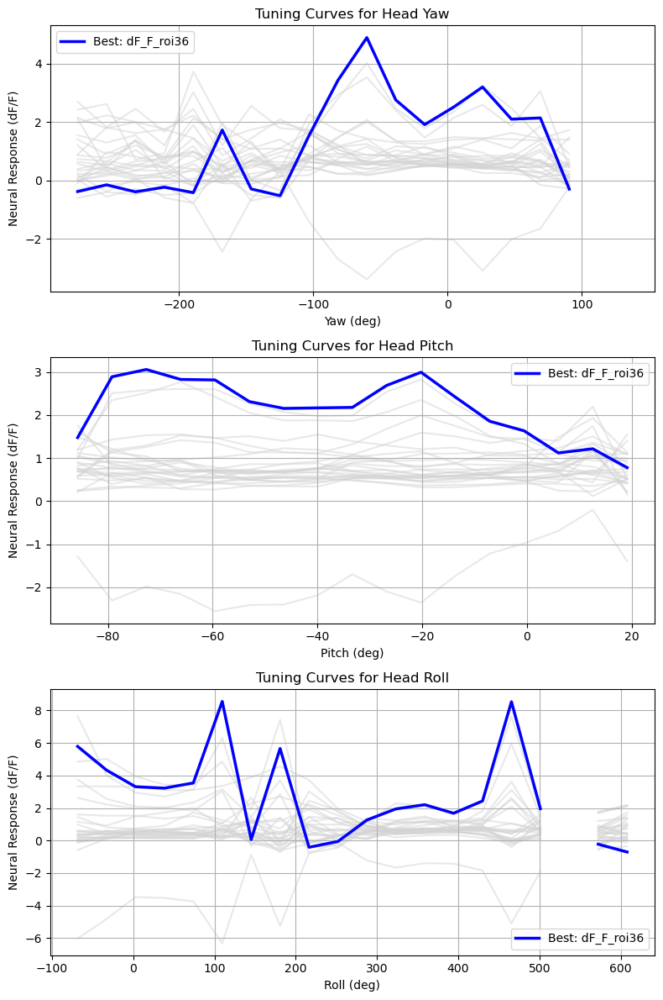

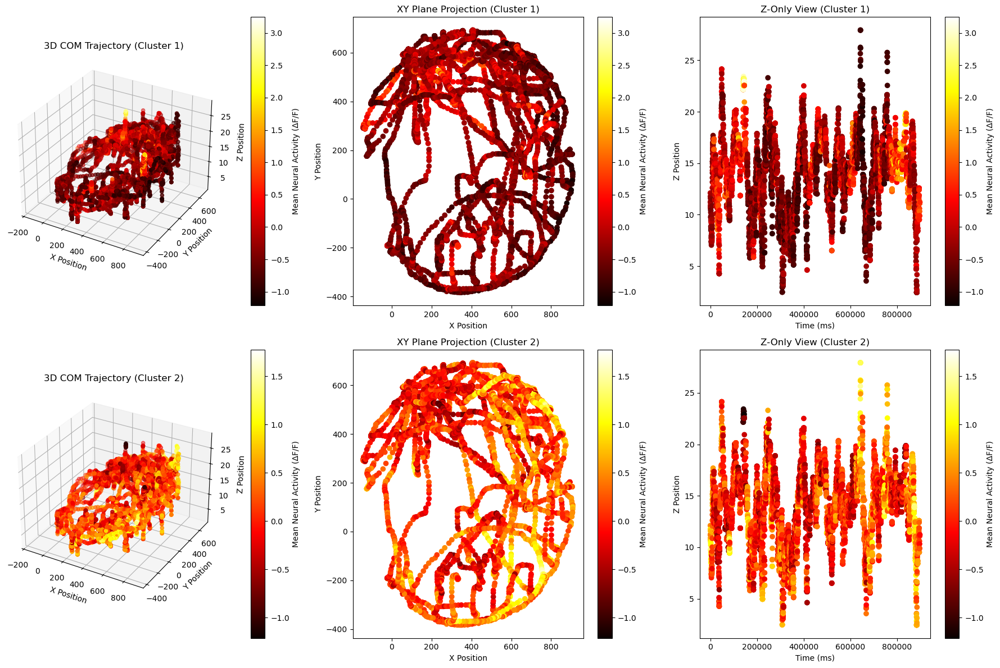


Running analysis for session: 2024_10_25_20241002PMCr2_17_05
Processing session: 2024_10_25_20241002PMCr2_17_05


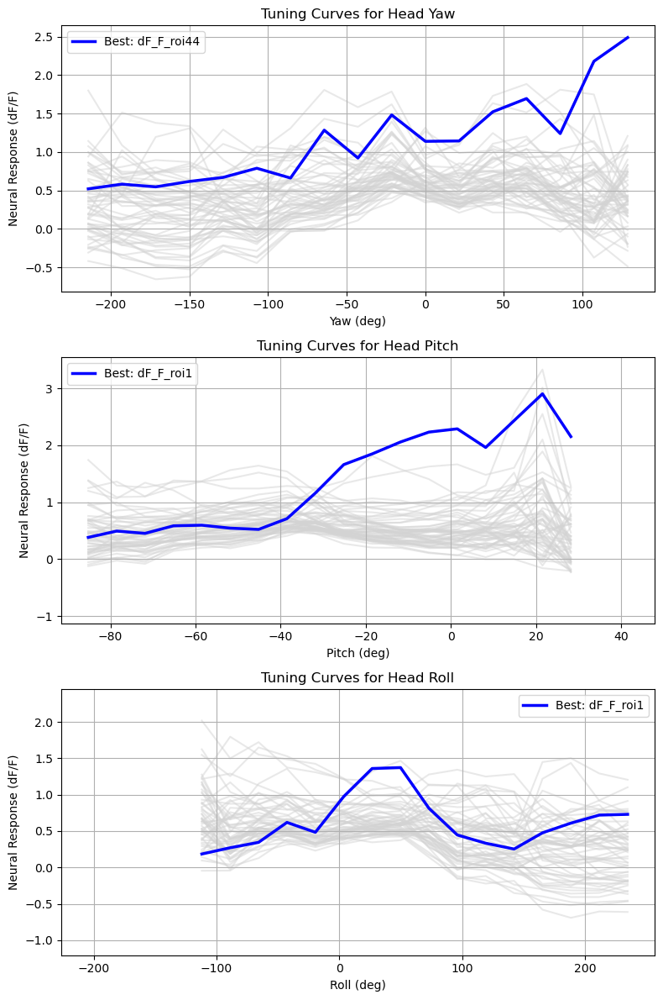

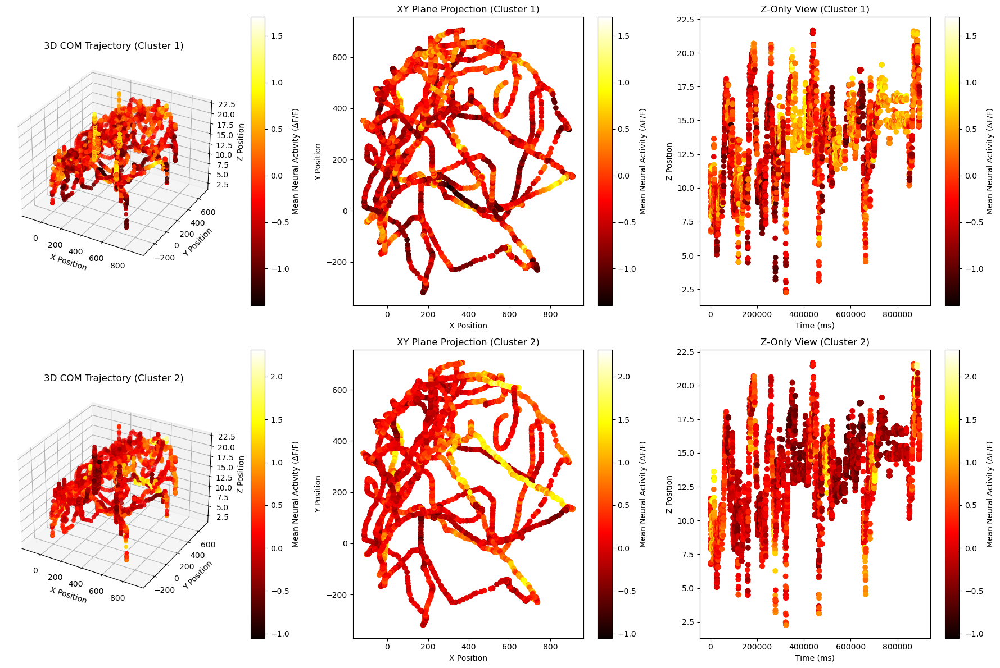


Running analysis for session: 2024_10_14_20240916v1r1_16_37
Processing session: 2024_10_14_20240916v1r1_16_37


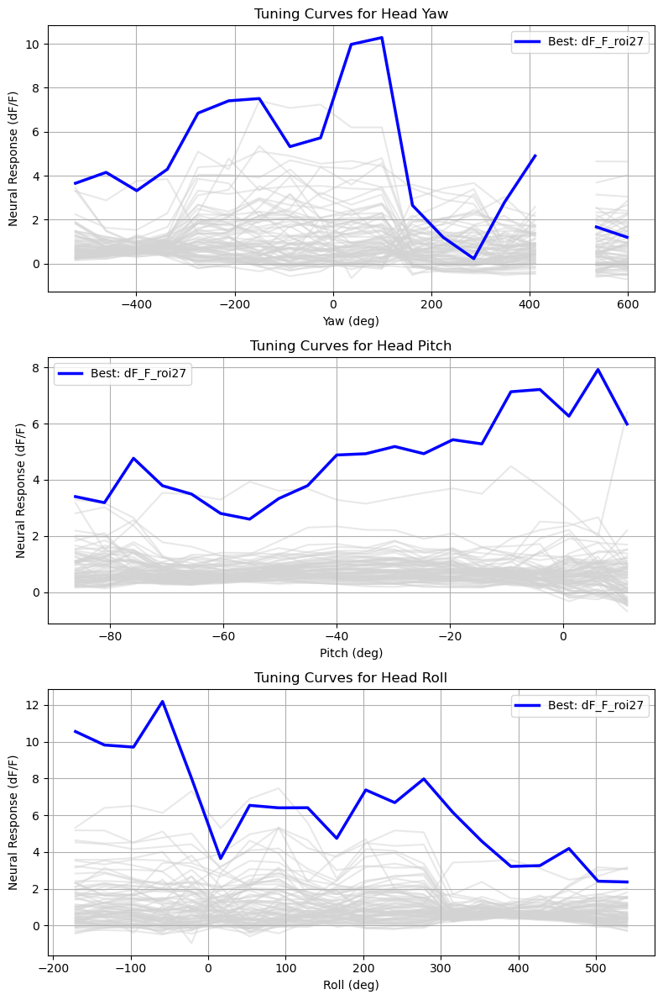

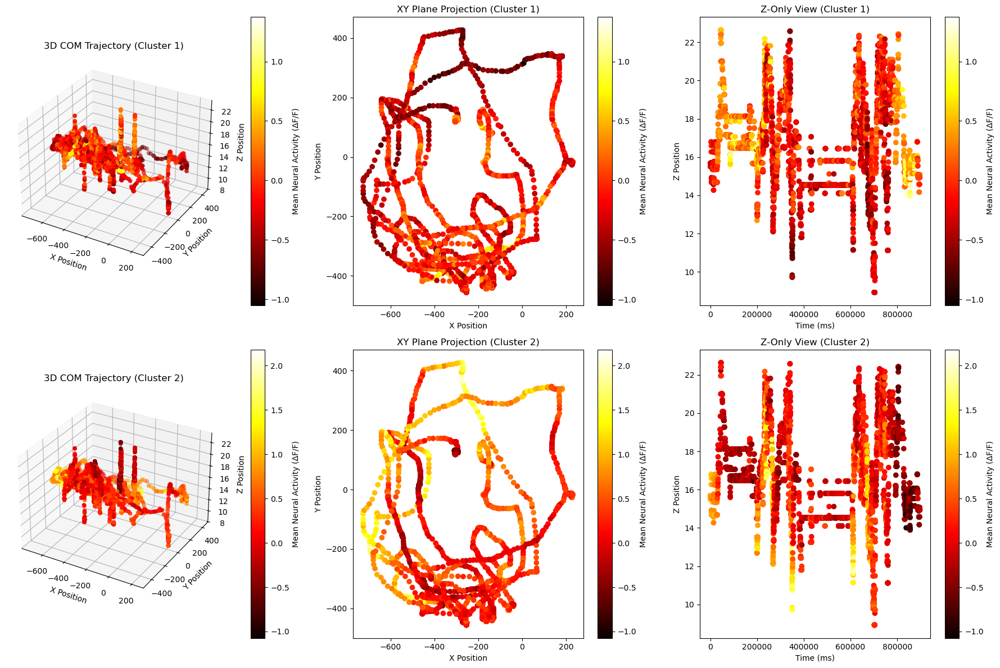


Running analysis for session: 2024_10_14_20240916v1r1_16_53
Processing session: 2024_10_14_20240916v1r1_16_53


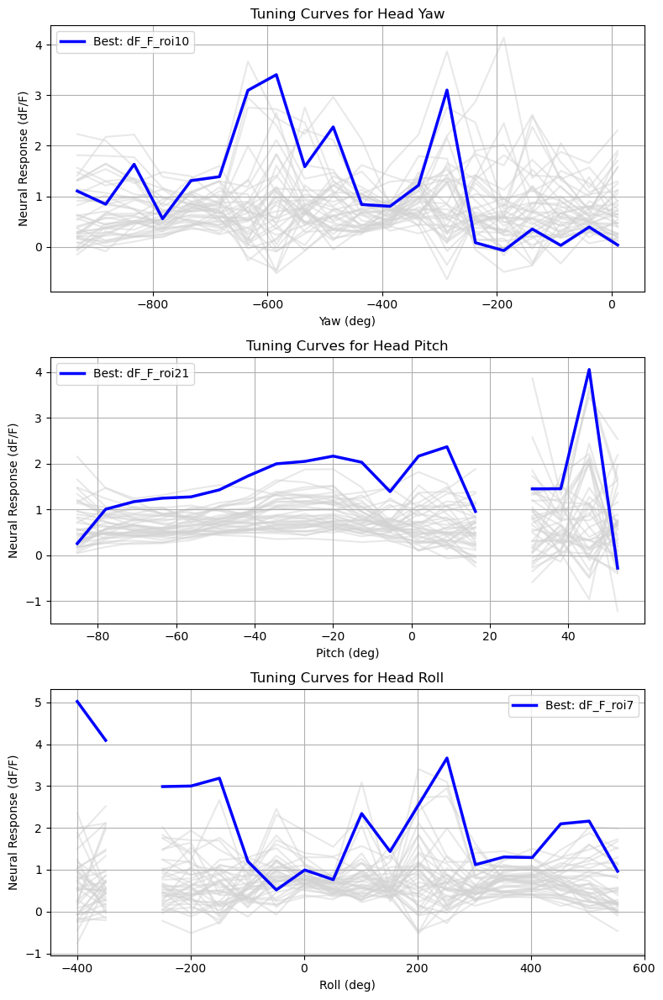

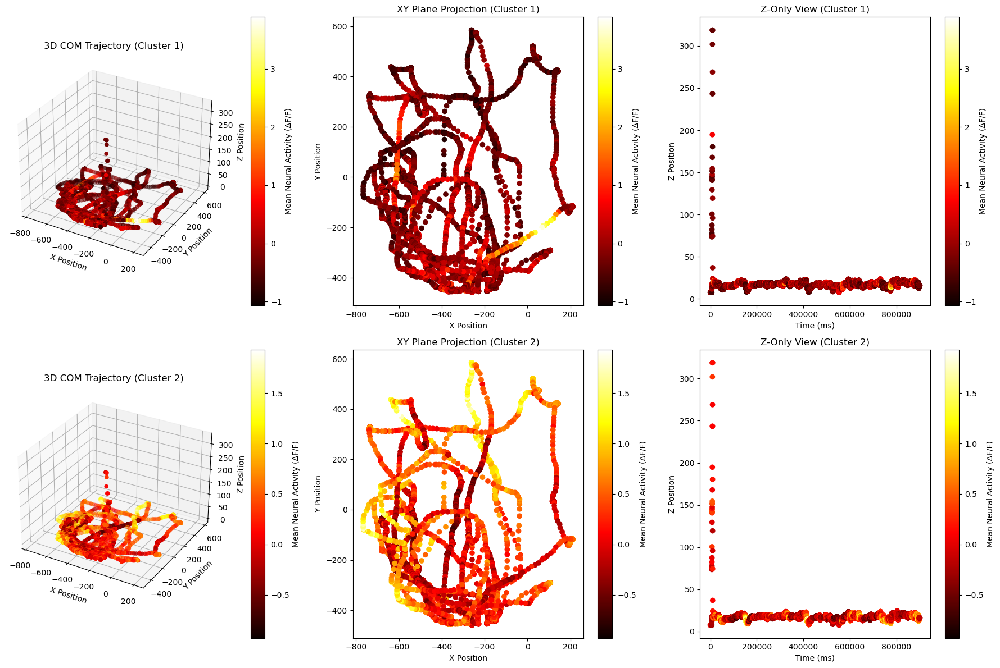


Running analysis for session: 2024_10_14_20240916v1r2_14_30
Processing session: 2024_10_14_20240916v1r2_14_30


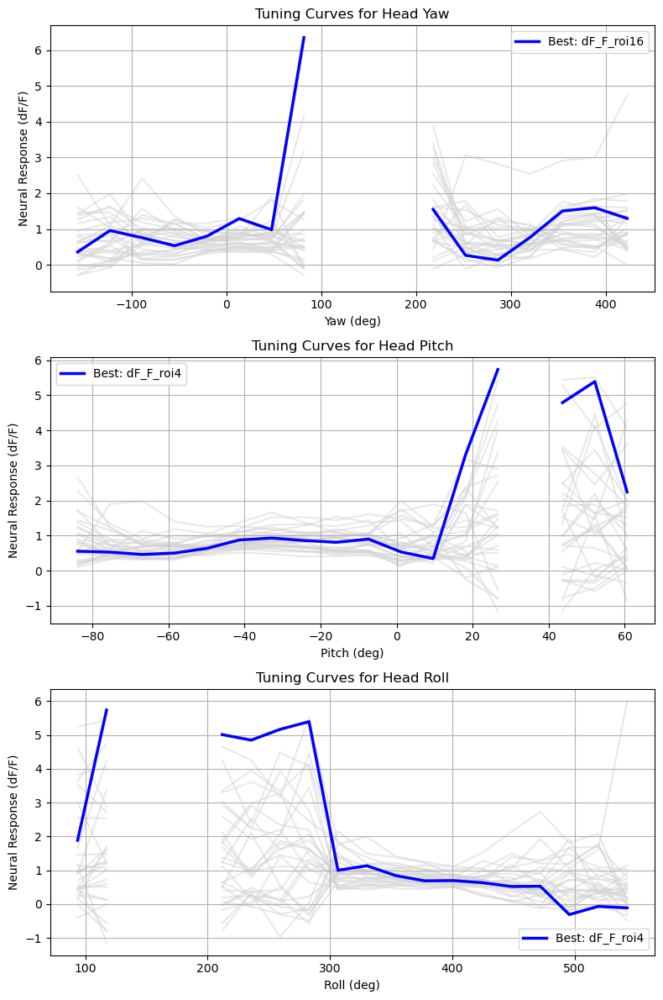

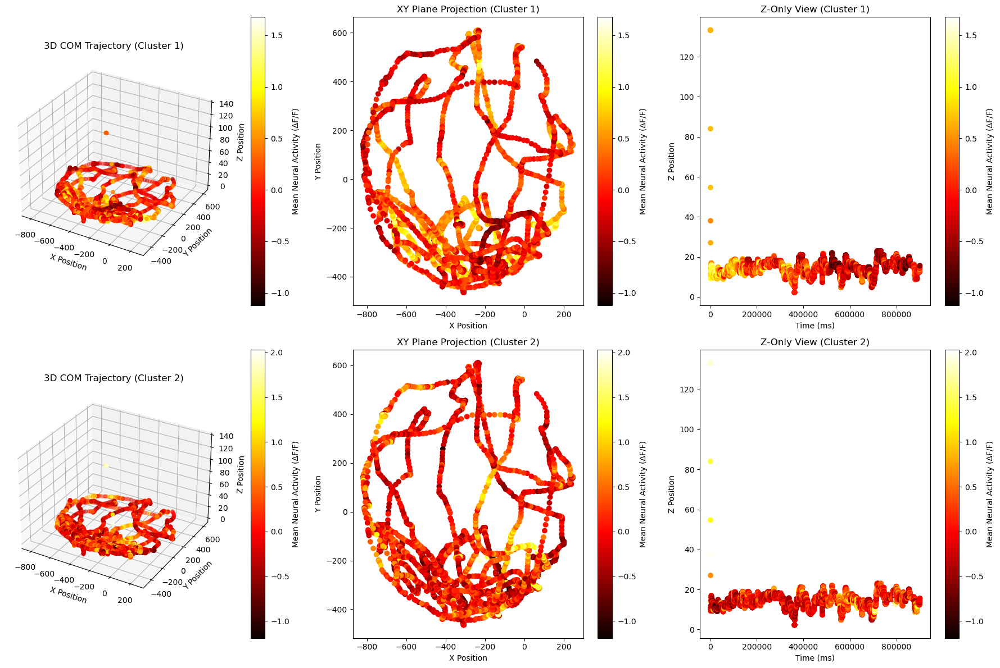


Running analysis for session: 2024_10_14_20240916v1r2_15_58
Processing session: 2024_10_14_20240916v1r2_15_58


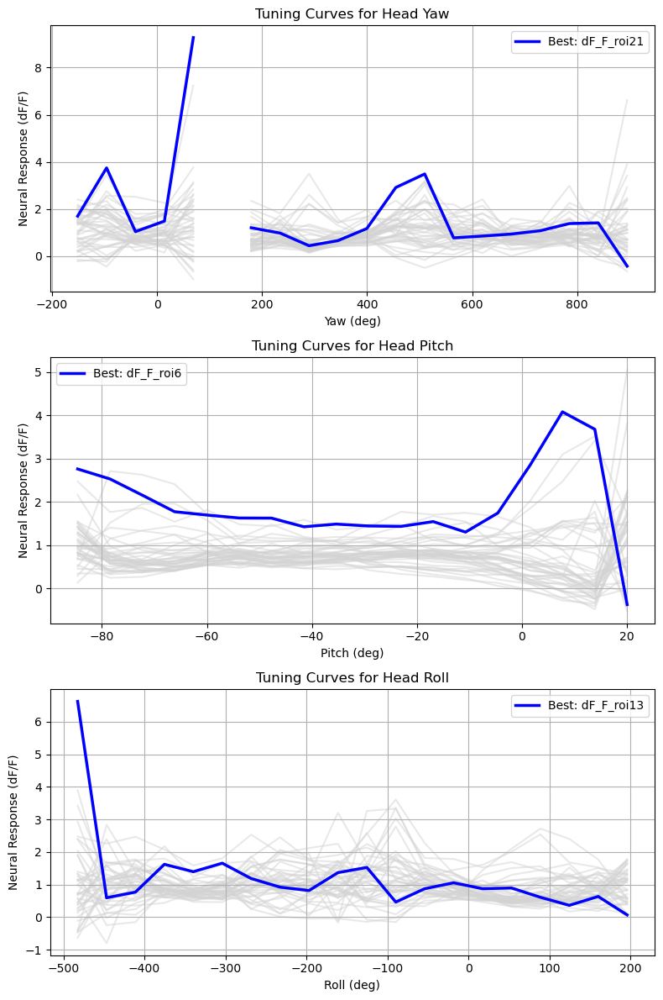

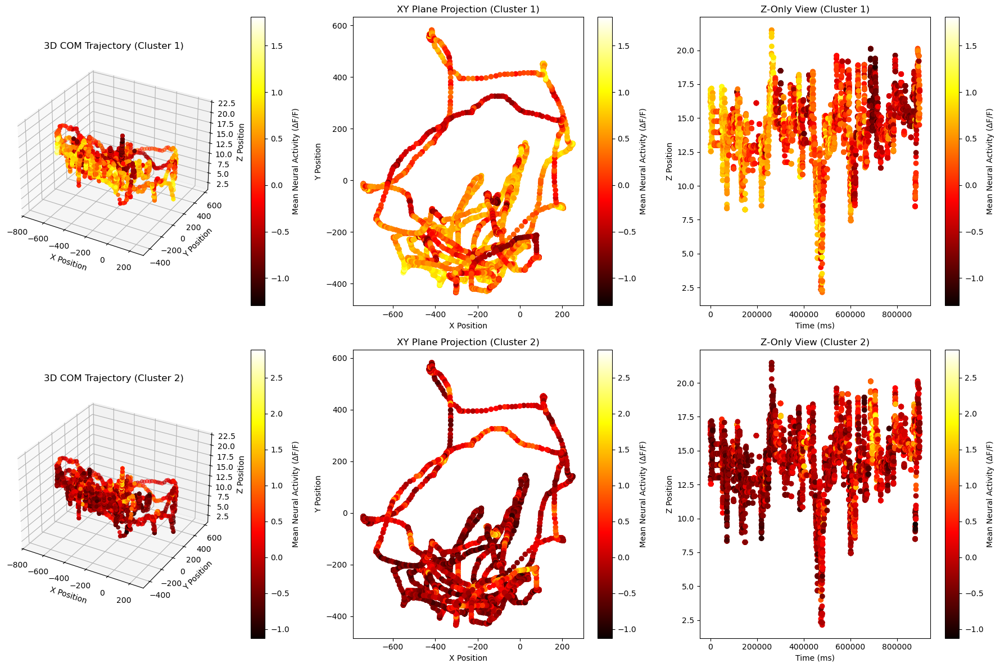


Running analysis for session: 2024_11_01_20240910V1r_AO_12_50
Processing session: 2024_11_01_20240910V1r_AO_12_50


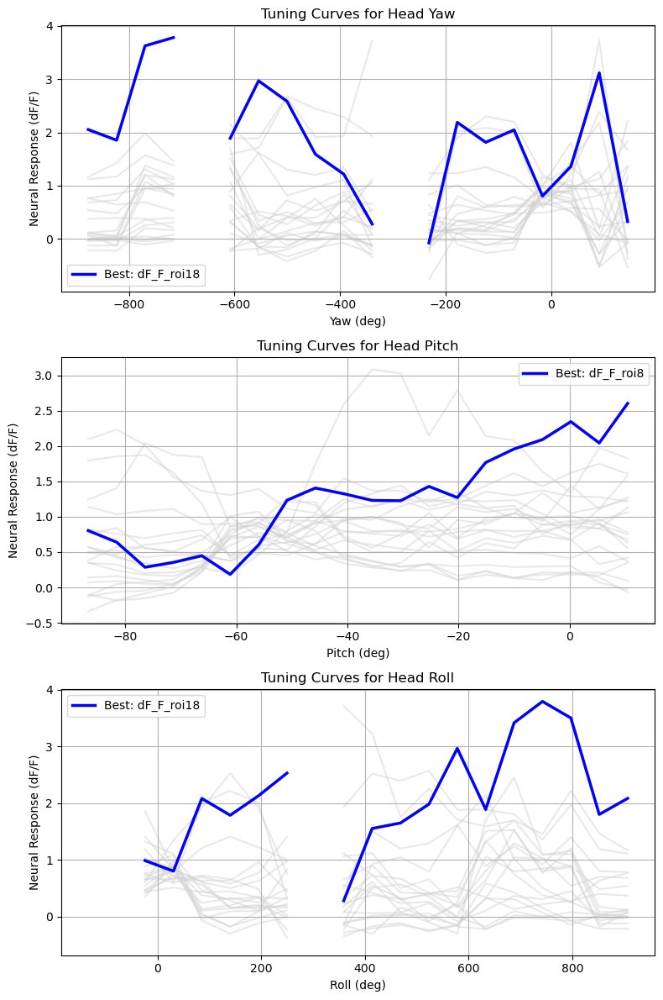

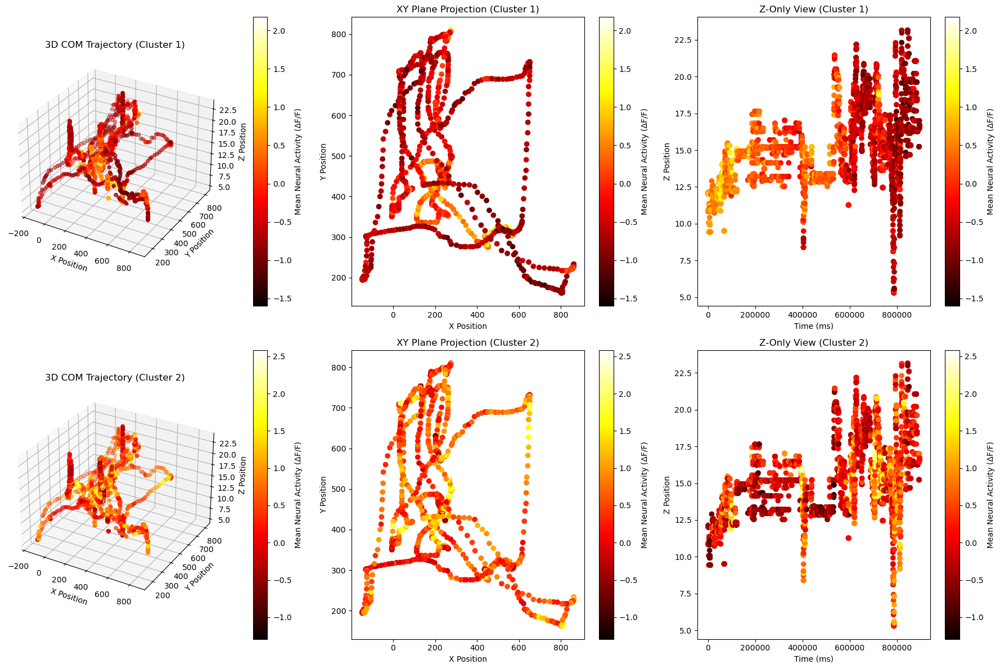


Running analysis for session: 2024_11_06_20241015pmcr2_16_53
Processing session: 2024_11_06_20241015pmcr2_16_53


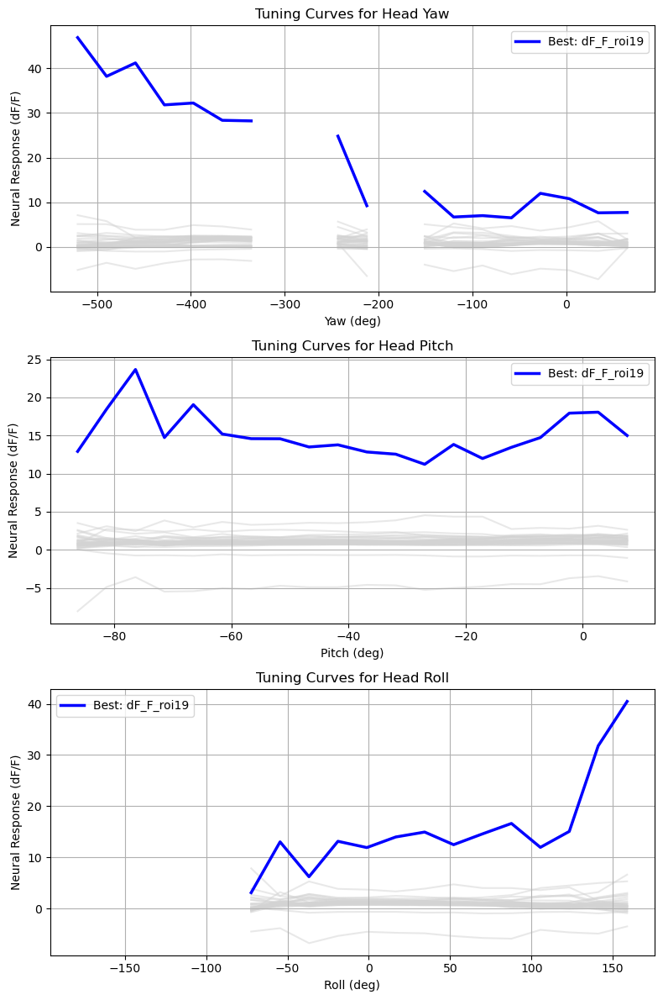

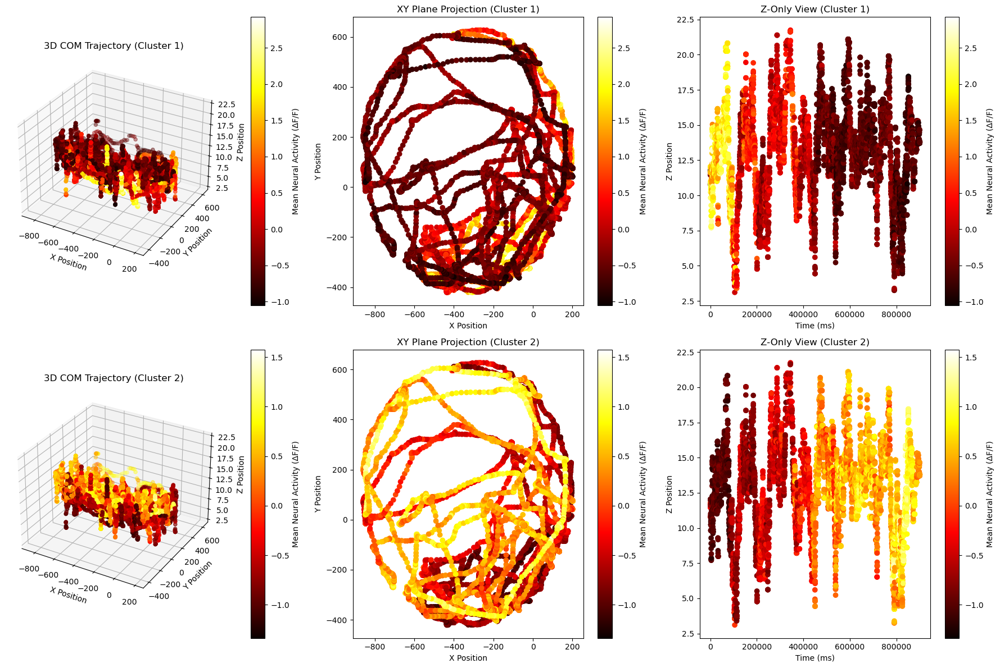

Session analysis completed.


In [19]:
import json
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.transform import Rotation as R
from scipy.cluster.hierarchy import linkage, fcluster
from scipy.stats import zscore

# -----------------------------
# Utility Functions
# -----------------------------
def load_data(hdf5_file_path, session_id=None):
    """Load HDF5 file and attach a session_id column."""
    df = pd.read_hdf(hdf5_file_path, key='df')
    if session_id is not None:
        df['session_id'] = session_id
    return df

def normalize(v):
    norm = np.linalg.norm(v)
    return v if norm < 1e-8 else v / norm

def compute_euler_angles_from_row(row):
    """Compute head Euler angles (relative to body) for one frame."""
    def get_kp(idx):
        return np.array([row[f'kp{idx}_x'], row[f'kp{idx}_y'], row[f'kp{idx}_z']])
    
    # Head coordinate frame (EarL=1, EarR=2, Snout=3)
    earL = get_kp(1)
    earR = get_kp(2)
    snout = get_kp(3)
    ear_mid = (earL + earR) / 2.0
    head_x = normalize(snout - ear_mid)
    temp_y = earR - earL
    head_y = normalize(temp_y - np.dot(temp_y, head_x) * head_x)
    head_z = normalize(np.cross(head_x, head_y))
    
    # Body coordinate frame (SpineF=4, SpineM=5, ShoulderL=12, ShoulderR=16)
    spineF = get_kp(4)
    spineM = get_kp(5)
    shoulderL = get_kp(12)
    shoulderR = get_kp(16)
    body_x = normalize(spineF - spineM)
    shoulder_vec = shoulderR - shoulderL
    body_y = normalize(shoulder_vec - np.dot(shoulder_vec, body_x) * body_x)
    body_z = normalize(np.cross(body_x, body_y))
    
    # Compute relative rotation from body to head.
    R_body = np.column_stack((body_x, body_y, body_z))
    R_head = np.column_stack((head_x, head_y, head_z))
    R_rel = np.dot(R_body.T, R_head)
    euler_angles = R.from_matrix(R_rel).as_euler('xyz', degrees=True)
    return euler_angles

def compute_all_euler_angles(df):
    """Compute Euler angles for all frames and add them as columns to df."""
    nframes = len(df)
    yaw_vals   = np.empty(nframes)
    pitch_vals = np.empty(nframes)
    roll_vals  = np.empty(nframes)
    for i in range(nframes):
        row = df.iloc[i]
        euler = compute_euler_angles_from_row(row)
        yaw_vals[i]   = euler[0]
        pitch_vals[i] = euler[1]
        roll_vals[i]  = euler[2]
    # Unwrap angles and convert to degrees.
    yaw_vals = np.degrees(np.unwrap(np.radians(yaw_vals)))
    pitch_vals = np.degrees(np.unwrap(np.radians(pitch_vals)))
    roll_vals = np.degrees(np.unwrap(np.radians(roll_vals)))
    df['Yaw'] = yaw_vals
    df['Pitch'] = pitch_vals
    df['Roll'] = roll_vals
    return yaw_vals, pitch_vals, roll_vals

def get_neural_columns(df, prefix='dF_F_roi'):
    """Retrieve neural signal columns based on prefix."""
    return [col for col in df.columns if col.startswith(prefix)]

def exclude_neurons(df, neural_columns, exclude_indices, outlier_sigma=3):
    """
    Exclude neurons based on outlier criteria and manual indices.
    """
    # Outlier exclusion based on max activity.
    neuron_max_vals = {neuron: df[neuron].max() for neuron in neural_columns}
    max_array = np.array(list(neuron_max_vals.values()))
    mean_max = np.mean(max_array)
    std_max = np.std(max_array)
    threshold = mean_max + outlier_sigma * std_max
    outlier_neurons = [neuron for neuron, val in neuron_max_vals.items() if val > threshold]
    
    # Manual exclusion.
    manual_excluded_neurons = [f'dF_F_roi{i}' for i in exclude_indices]
    clean_neural_columns = [
        neuron for neuron in neural_columns 
        if (neuron not in outlier_neurons and neuron not in manual_excluded_neurons)
    ]
    return clean_neural_columns

def compute_tuning_curve(angle_vals, neural_vals, nbins=20):
    """
    Bin angle values and compute the mean neural response for each bin.
    """
    bins = np.linspace(np.min(angle_vals), np.max(angle_vals), nbins + 1)
    bin_centers = (bins[:-1] + bins[1:]) / 2.0
    avg_response = np.zeros(nbins)
    for i in range(nbins):
        mask = (angle_vals >= bins[i]) & (angle_vals < bins[i+1])
        avg_response[i] = np.mean(neural_vals[mask]) if np.any(mask) else np.nan
    return bin_centers, avg_response

def select_best_neuron(df, angle_vals, clean_neural_columns, nbins=20):
    """
    Select the neuron with the highest tuning curve variance for a given angle.
    """
    best_metric = -np.inf
    selected_neuron = None
    for neuron in clean_neural_columns:
        neural_vals = df[neuron].values
        _, tuning = compute_tuning_curve(angle_vals, neural_vals, nbins)
        metric = np.nanvar(tuning)
        if metric > best_metric:
            best_metric = metric
            selected_neuron = neuron
    return selected_neuron

def plot_tuning_curves(df, yaw_vals, pitch_vals, roll_vals, clean_neural_columns, best_neurons, nbins=20):
    """Plot tuning curves for Yaw, Pitch, and Roll."""
    fig, axes = plt.subplots(3, 1, figsize=(8, 12), sharex=False)
    angle_names = ['Yaw', 'Pitch', 'Roll']
    angle_vals_list = [yaw_vals, pitch_vals, roll_vals]
    
    for ax, angle_name, angle_vals in zip(axes, angle_names, angle_vals_list):
        # Plot all neurons in background.
        for neuron in clean_neural_columns:
            neural_vals = df[neuron].values
            centers, tuning = compute_tuning_curve(angle_vals, neural_vals, nbins)
            ax.plot(centers, tuning, linestyle='-', color='lightgray', alpha=0.5, zorder=1)
        
        # Highlight best neuron.
        neuron = best_neurons[angle_name]
        neural_vals = df[neuron].values
        centers, tuning = compute_tuning_curve(angle_vals, neural_vals, nbins)
        ax.plot(centers, tuning, linestyle='-', color='blue', lw=2.5, label=f'Best: {neuron}', zorder=2)
        ax.set_title(f'Tuning Curves for Head {angle_name}')
        ax.set_xlabel(f'{angle_name} (deg)')
        ax.set_ylabel('Neural Response (dF/F)')
        ax.legend()
        ax.grid(True)
    plt.tight_layout()
    plt.show()

def clustering_analysis(df, clean_neural_columns, num_clusters=2):
    """
    Cluster neurons based on their activity and plot cluster analysis views.
    """
    # Reset index without dropping so that 'timestamp_ms_mini' is preserved as a column.
    df_new = df.copy().reset_index()
    time = df_new['timestamp_ms_mini']
    neuron_activity = df_new[clean_neural_columns].values.T  # shape: (neurons, timepoints)
    
    # Drop low-variance neurons.
    neuron_variances = np.var(neuron_activity, axis=1)
    threshold = np.percentile(neuron_variances, 5)
    high_variance_indices = neuron_variances > threshold
    neuron_activity_filtered = neuron_activity[high_variance_indices, :]
    filtered_neural_columns = [col for i, col in enumerate(clean_neural_columns) if high_variance_indices[i]]
    
    # Z-score normalization.
    neuron_activity_normalized = zscore(neuron_activity_filtered, axis=1)
    Z = linkage(neuron_activity_normalized, method='average', metric='correlation')
    cluster_labels = fcluster(Z, t=num_clusters, criterion='maxclust')
    
    # Compute cluster mean activity.
    cluster_means = []
    for cluster_id in range(1, num_clusters + 1):
        cluster_neurons = neuron_activity_normalized[cluster_labels == cluster_id, :]
        cluster_mean = cluster_neurons.mean(axis=0)
        cluster_means.append(cluster_mean)
    cluster_means = np.array(cluster_means)
    
    # Plot cluster analysis results.
    fig = plt.figure(figsize=(18, 12))
    for cluster_id in range(num_clusters):
        row_offset = cluster_id * 3
        # 3D COM Trajectory.
        ax1 = fig.add_subplot(2, 3, row_offset + 1, projection='3d')
        sc1 = ax1.scatter(df_new['com_x'], df_new['com_y'], df_new['com_z'],
                          c=cluster_means[cluster_id, :len(df_new)], cmap='hot', marker='o')
        ax1.set_title(f'3D COM Trajectory (Cluster {cluster_id + 1})')
        ax1.set_xlabel('X Position')
        ax1.set_ylabel('Y Position')
        ax1.set_zlabel('Z Position')
        fig.colorbar(sc1, ax=ax1, pad=0.1, label='Mean Neural Activity (ΔF/F)')
        
        # XY Plane Projection.
        ax2 = fig.add_subplot(2, 3, row_offset + 2)
        sc2 = ax2.scatter(df_new['com_x'], df_new['com_y'],
                          c=cluster_means[cluster_id, :len(df_new)], cmap='hot', marker='o')
        ax2.set_title(f'XY Plane Projection (Cluster {cluster_id + 1})')
        ax2.set_xlabel('X Position')
        ax2.set_ylabel('Y Position')
        fig.colorbar(sc2, ax=ax2, label='Mean Neural Activity (ΔF/F)')
        
        # Z-Only View.
        ax3 = fig.add_subplot(2, 3, row_offset + 3)
        sc3 = ax3.scatter(time, df_new['com_z'],
                          c=cluster_means[cluster_id, :len(df_new)], cmap='hot', marker='o')
        ax3.set_title(f'Z-Only View (Cluster {cluster_id + 1})')
        ax3.set_xlabel('Time (ms)')
        ax3.set_ylabel('Z Position')
        fig.colorbar(sc3, ax=ax3, label='Mean Neural Activity (ΔF/F)')
    plt.tight_layout()
    plt.show()
    return cluster_labels, filtered_neural_columns

# -----------------------------
# Pipeline for a Single Session
# -----------------------------
def run_single_session(session_params):
    """
    Run the analysis pipeline for a single session.
    
    session_params should be a dictionary with keys:
      - 'file_path'
      - 'session_id'
      - 'exclude_indices': list of neuron indices to exclude manually
    """
    print(f"Processing session: {session_params.get('session_id', 'unknown')}")
    # Load data.
    df = load_data(session_params['file_path'], session_id=session_params.get('session_id'))
    
    # Compute Euler angles.
    yaw_vals, pitch_vals, roll_vals = compute_all_euler_angles(df)
    
    # Retrieve and clean neural columns.
    neural_columns = get_neural_columns(df)
    clean_neural_columns = exclude_neurons(df, neural_columns, session_params.get('exclude_indices', []))
    
    # Select the best neuron for each angle.
    best_neurons = {
        'Yaw': select_best_neuron(df, yaw_vals, clean_neural_columns),
        'Pitch': select_best_neuron(df, pitch_vals, clean_neural_columns),
        'Roll': select_best_neuron(df, roll_vals, clean_neural_columns)
    }
    
    # Plot tuning curves.
    plot_tuning_curves(df, yaw_vals, pitch_vals, roll_vals, clean_neural_columns, best_neurons)
    
    # Perform clustering analysis.
    cluster_labels, filtered_neural_columns = clustering_analysis(df, clean_neural_columns)
    
    return {
        'session_id': session_params.get('session_id'),
        'best_neurons': best_neurons,
        'cluster_labels': cluster_labels,
        'filtered_neural_columns': filtered_neural_columns
    }

# -----------------------------
# Main: Run Sessions with Exclusion from JSON
# -----------------------------
if __name__ == '__main__':
    # Base path to prepend to session relative paths.
    base_path = "/data/big_rim/rsync_dcc_sum/Oct3V1"
    
    # Load exclusion indices from JSON.
    exclude_file = "/home/lq53/mir_repos/BBOP/random_tests/25feb_more_corr_explo/neuro_exclude.json"
    with open(exclude_file, "r") as f:
        exclude_dict = json.load(f)
    
    # List of session relative paths.
    recordings = [
        '2024_10_25/20241002PMCr2_15_42',
        '2024_10_25/20241002PMCr2_17_05',
        '2024_10_14/20240916v1r1_16_37',
        '2024_10_14/20240916v1r1_16_53',
        '2024_10_14/20240916v1r2_14_30',
        '2024_10_14/20240916v1r2_15_58',
        '2024_11_01/20240910V1r_AO_12_50',
        '2024_11_06/20241015pmcr2_16_53'
    ]
    
    results = []
    for rec in recordings:
        # Construct the session directory and the full file path.
        session_dir = f"{base_path}/{rec}"
        file_path = f"{session_dir}/MIR_Aligned/aligned_predictions_with_ca_and_dF_F.h5"
        # Compute session id by replacing "/" with "_".
        session_id = rec.replace("/", "_")
        # Get exclude indices from JSON if present; otherwise, use an empty list.
        exclude_indices = exclude_dict.get(session_dir, [])
        
        session_params = {
            'file_path': file_path,
            'session_id': session_id,
            'exclude_indices': exclude_indices
        }
        print(f"\nRunning analysis for session: {session_id}")
        res = run_single_session(session_params)
        results.append(res)
    
    print("Session analysis completed.")


Plotting session from: /data/big_rim/rsync_dcc_sum/Oct3V1/2024_10_25/20241002PMCr2_15_42


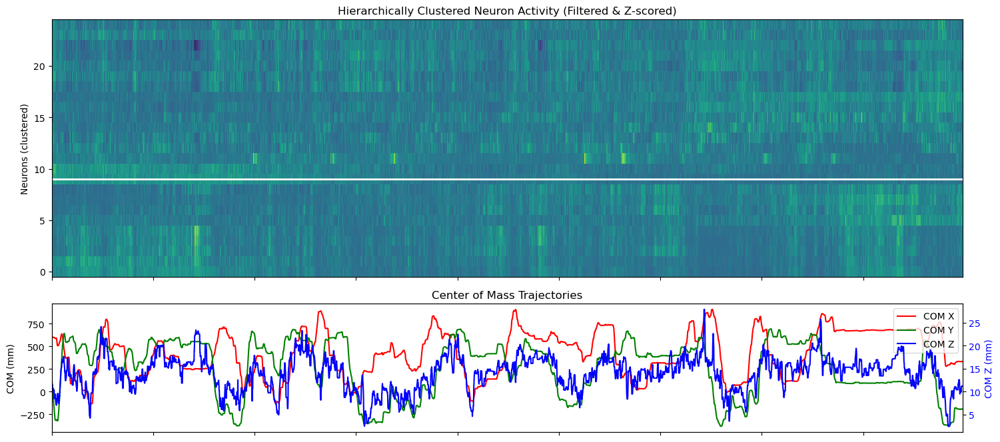

Plotting session from: /data/big_rim/rsync_dcc_sum/Oct3V1/2024_10_25/20241002PMCr2_17_05


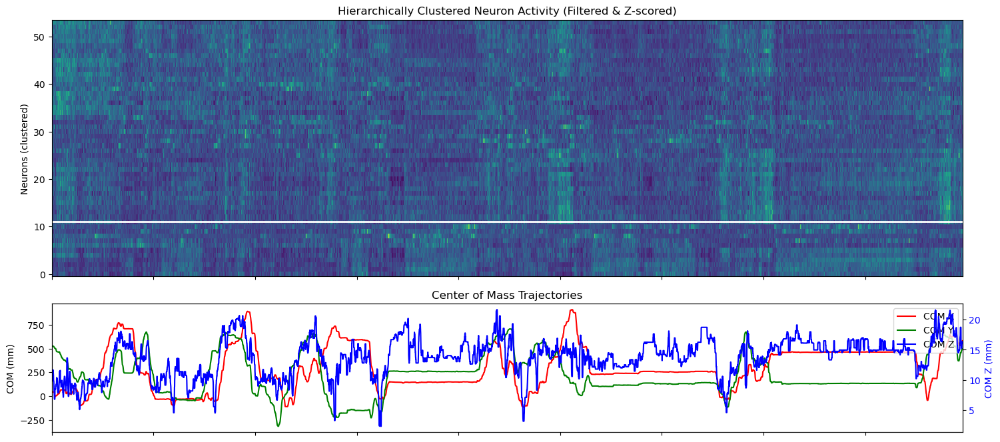

Plotting session from: /data/big_rim/rsync_dcc_sum/Oct3V1/2024_10_14/20240916v1r1_16_37


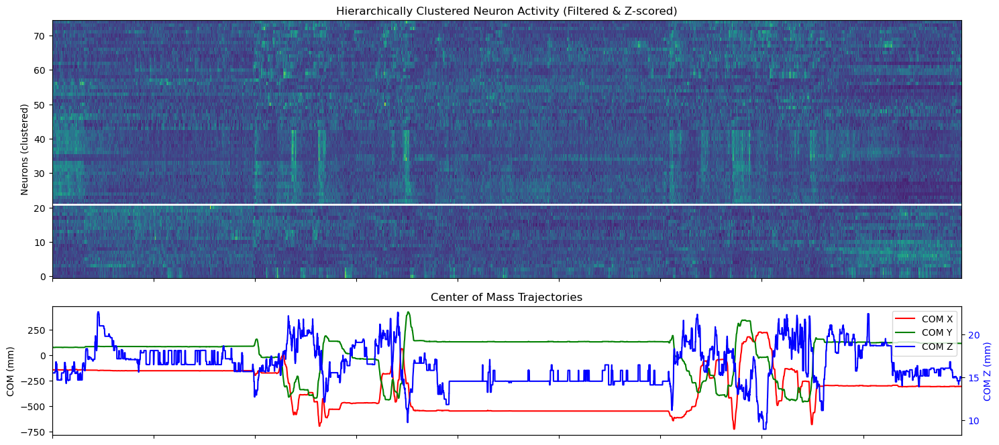

Plotting session from: /data/big_rim/rsync_dcc_sum/Oct3V1/2024_10_14/20240916v1r1_16_53


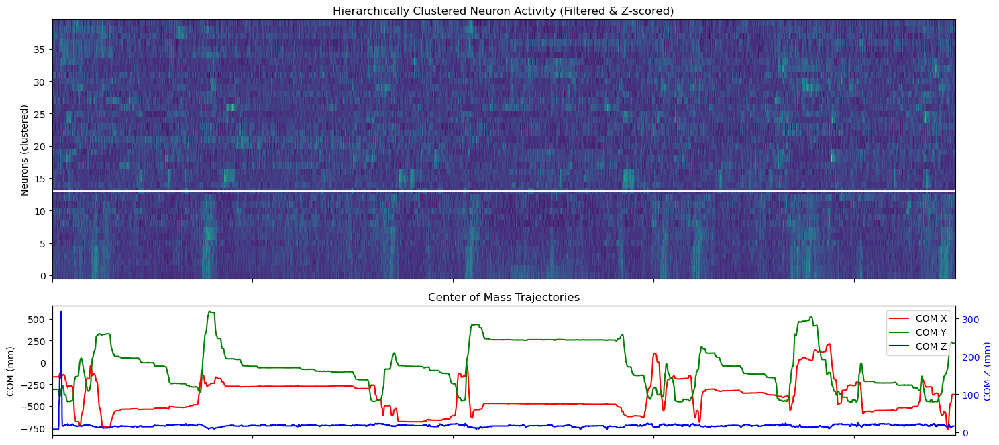

Plotting session from: /data/big_rim/rsync_dcc_sum/Oct3V1/2024_10_14/20240916v1r2_14_30


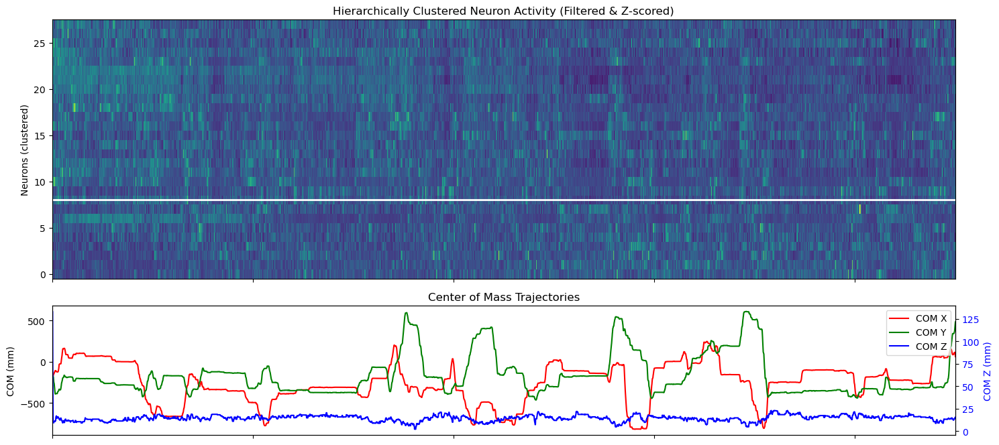

Plotting session from: /data/big_rim/rsync_dcc_sum/Oct3V1/2024_10_14/20240916v1r2_15_58


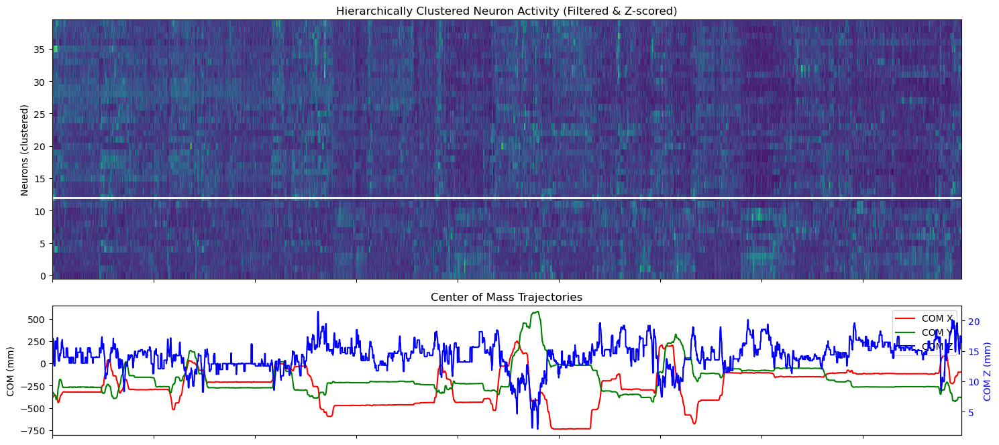

Plotting session from: /data/big_rim/rsync_dcc_sum/Oct3V1/2024_11_01/20240910V1r_AO_12_50


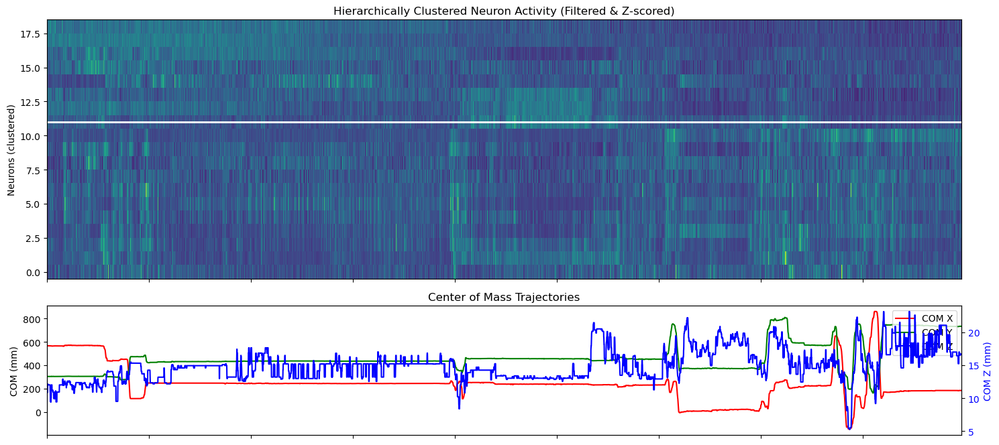

Plotting session from: /data/big_rim/rsync_dcc_sum/Oct3V1/2024_11_06/20241015pmcr2_16_53


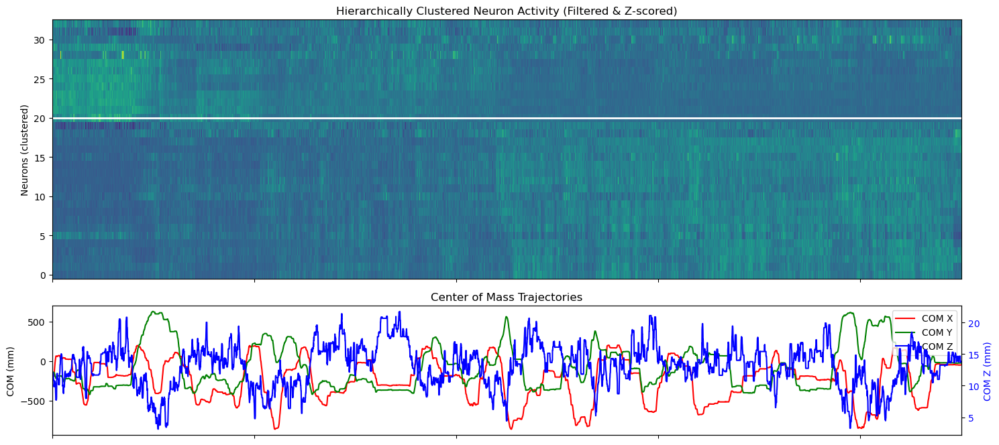

In [20]:
import os
import json
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import linkage, leaves_list, fcluster
from scipy.stats import zscore

# ------------------------------------------------------------------------------
# 1. Load the JSON file with excluded neurons mapping
# ------------------------------------------------------------------------------
exclude_json_path = '/home/lq53/mir_repos/BBOP/random_tests/25feb_more_corr_explo/neuro_exclude.json'
with open(exclude_json_path, 'r') as f:
    exclude_dict = json.load(f)

def get_excluded_neurons_for_session(session_path, exclude_dict):
    """
    Given a session path and the exclusion dictionary loaded from JSON,
    return the list of excluded neuron indices.
    If an exact match is not found, try to match by substring.
    """
    if session_path in exclude_dict:
        return exclude_dict[session_path]
    for key, val in exclude_dict.items():
        if key in session_path:
            return val
    return []  # Default to no exclusions if not found

# ------------------------------------------------------------------------------
# 2. Data Loading with Metadata
# ------------------------------------------------------------------------------
def load_session_data(rec_path):
    """
    Load a single session's HDF5 file, parse the folder structure to extract metadata,
    and return the resulting DataFrame with added metadata columns.
    
    Expected folder structure:
      {base_path}/{recording_date}/{session_id}
      
    For example:
      /data/big_rim/rsync_dcc_sum/Oct3V1/2024_10_25/20241002PMCr2_15_42

    Extracted metadata:
      - session_id    = 20241002PMCr2_15_42  (last directory)
      - recording_date = 2024_10_25          (parent directory)
      - experiment    = Oct3V1              (grandparent directory)
    """
    hdf5_file_path = os.path.join(rec_path, 'MIR_Aligned', 'aligned_predictions_with_ca_and_dF_F.h5')
    df = pd.read_hdf(hdf5_file_path, key='df')
    
    norm_path = os.path.normpath(rec_path)
    session_id = os.path.basename(norm_path)
    recording_date = os.path.basename(os.path.dirname(norm_path))
    experiment_name = os.path.basename(os.path.dirname(os.path.dirname(norm_path)))
    
    df['session_id'] = session_id
    df['recording_date'] = recording_date
    df['experiment'] = experiment_name
    df['session_path'] = rec_path
    df['file_path'] = hdf5_file_path
    
    return df

# ------------------------------------------------------------------------------
# 3. Processing Neuron Activity Data with Optional Exclusion
# ------------------------------------------------------------------------------
def process_neuron_activity(df, exclude_dict=None, manual_exclude_indices=None, apply_exclusion=True):
    """
    Process neuron activity data:
      - Optionally exclude specific neurons.
      - Remove low-variance neurons.
      - Z-score normalize each neuron's time course.
    
    Returns:
      - neuron_activity_normalized: np.array of shape (neurons, timepoints)
      - filtered_neuron_columns: list of neuron column names after filtering
      - df_new: DataFrame with reset index (should contain timestamp info)
    """
    if apply_exclusion:
        if manual_exclude_indices is not None:
            excluded_indices = manual_exclude_indices
        elif exclude_dict is not None:
            session_path = df['session_path'].iloc[0]
            excluded_indices = get_excluded_neurons_for_session(session_path, exclude_dict)
        else:
            excluded_indices = []
    else:
        excluded_indices = []
    
    manual_excluded_neurons = [f'dF_F_roi{i}' for i in excluded_indices]
    
    neuron_columns = [
        col for col in df.columns 
        if col.startswith('dF_F_roi') and col not in manual_excluded_neurons
    ]
    
    neuron_activity = df[neuron_columns].values.T  # shape: (neurons, timepoints)
    
    # Remove low-variance neurons (keep top 95% variance)
    neuron_variances = np.var(neuron_activity, axis=1)
    threshold = np.percentile(neuron_variances, 5)
    high_variance_indices = neuron_variances > threshold
    neuron_activity_filtered = neuron_activity[high_variance_indices, :]
    filtered_neuron_columns = [col for i, col in enumerate(neuron_columns) if high_variance_indices[i]]
    
    neuron_activity_normalized = zscore(neuron_activity_filtered, axis=1)
    
    df_new = df.reset_index()
    
    return neuron_activity_normalized, filtered_neuron_columns, df_new

# ------------------------------------------------------------------------------
# 4. Plotting Function with Cluster Boundaries
# ------------------------------------------------------------------------------
def plot_session_data(df, exclude_dict=None, manual_exclude_indices=None, apply_exclusion=True):
    """
    Produce a figure with:
      - A heatmap of hierarchically clustered neuron activity with cluster boundaries.
      - Center of mass (COM) trajectories.
    
    Expects the DataFrame to have a 'timestamp_ms_mini' column for the x-axis.
    """
    neuron_activity_normalized, filtered_neuron_columns, df_new = process_neuron_activity(
        df, exclude_dict=exclude_dict, manual_exclude_indices=manual_exclude_indices, apply_exclusion=apply_exclusion
    )
    time = df_new['timestamp_ms_mini']
    
    fig = plt.figure(figsize=(15, 10))
    gs = fig.add_gridspec(nrows=3, ncols=1, height_ratios=[2, 1, 1.5])
    
    # --- Plot 1: Ca²⁺ Heatmap with Cluster Boundaries ---
    ax1 = fig.add_subplot(gs[0, 0])
    if neuron_activity_normalized is not None and filtered_neuron_columns is not None:
        Z = linkage(neuron_activity_normalized, method='ward')
        neuron_order = leaves_list(Z)
        neuron_activity_ordered = neuron_activity_normalized[neuron_order, :]
        ordered_neuron_columns = [filtered_neuron_columns[i] for i in neuron_order]
        
        # Compute clusters (e.g., using 2 clusters; adjust as needed)
        num_clusters = 2
        cluster_labels = fcluster(Z, t=num_clusters, criterion='maxclust')
        cluster_labels_ordered = cluster_labels[neuron_order]
        
        neuron_indices = np.arange(len(neuron_activity_ordered))
        mesh = ax1.pcolormesh(
            time, neuron_indices, neuron_activity_ordered,
            cmap='viridis', shading='auto'
        )
        ax1.set_title('Hierarchically Clustered Neuron Activity (Filtered & Z-scored)')
        ax1.set_ylabel('Neurons (clustered)')
        
        # Draw horizontal lines where cluster membership changes
        boundaries = []
        for i in range(1, len(cluster_labels_ordered)):
            if cluster_labels_ordered[i] != cluster_labels_ordered[i - 1]:
                boundaries.append(i)
        for b in boundaries:
            ax1.axhline(b, color='white', linewidth=2)
    else:
        print("Neuron activity data not found. Skipping heatmap plot.")
        ax1.text(0.5, 0.5, 'No neuron activity data available.',
                 transform=ax1.transAxes, ha='center', va='center')
        ax1.set_title('No Neuron Activity Plot')
    ax1.tick_params(labelbottom=False)
    
    # --- Plot 2: Center of Mass (COM) Trajectories ---
    ax2 = fig.add_subplot(gs[1, 0], sharex=ax1)
    if {'com_x', 'com_y', 'com_z'}.issubset(df_new.columns):
        ax2.plot(time, df_new['com_x'], color='red', label='COM X')
        ax2.plot(time, df_new['com_y'], color='green', label='COM Y')
        ax2.set_ylabel('COM (mm)')
        ax2.set_title('Center of Mass Trajectories')
        
        ax2_right = ax2.twinx()
        ax2_right.plot(time, df_new['com_z'], color='blue', label='COM Z')
        ax2_right.set_ylabel('COM Z (mm)', color='blue')
        ax2_right.tick_params(axis='y', labelcolor='blue')
        
        lines_ax2, labels_ax2 = ax2.get_legend_handles_labels()
        lines_ax2_right, labels_ax2_right = ax2_right.get_legend_handles_labels()
        ax2.legend(lines_ax2 + lines_ax2_right, labels_ax2 + labels_ax2_right, loc='upper right')
    else:
        print("COM columns not found (com_x, com_y, com_z). Check your DataFrame.")
    ax2.tick_params(labelbottom=False)
    
    # (Additional subplots can be added here)
    plt.tight_layout()
    plt.show()

# ------------------------------------------------------------------------------
# 5. Main Block: Use Relative Session Paths
# ------------------------------------------------------------------------------
if __name__ == '__main__':
    # Define the base path and relative session paths.
    base_path = "/data/big_rim/rsync_dcc_sum/Oct3V1"
    recordings = [
        '2024_10_25/20241002PMCr2_15_42',
        '2024_10_25/20241002PMCr2_17_05',
        '2024_10_14/20240916v1r1_16_37',
        '2024_10_14/20240916v1r1_16_53',
        '2024_10_14/20240916v1r2_14_30',
        '2024_10_14/20240916v1r2_15_58',
        '2024_11_01/20240910V1r_AO_12_50',
        '2024_11_06/20241015pmcr2_16_53'
    ]
    
    for rec in recordings:
        # Construct full session path.
        session_path = os.path.join(base_path, rec)
        print(f"Plotting session from: {session_path}")
        df_session = load_session_data(session_path)
        # Plot with exclusion (if available in the JSON); change apply_exclusion to False to plot all neurons.
        plot_session_data(df_session, exclude_dict=exclude_dict, apply_exclusion=True)

    # Optionally, load multiple sessions into one DataFrame for group-level analysis.
    def load_multiple_sessions(rec_paths):
        session_dfs = []
        for rec in rec_paths:
            full_path = os.path.join(base_path, rec)
            df_session = load_session_data(full_path)
            session_dfs.append(df_session)
        df_all = pd.concat(session_dfs, ignore_index=True)
        return df_all

    df_all_sessions = load_multiple_sessions(recordings)
    # You can later filter df_all_sessions by metadata for further analysis.



Running analysis for session: 2024_10_25_20241002PMCr2_15_42
Processing session: 2024_10_25_20241002PMCr2_15_42


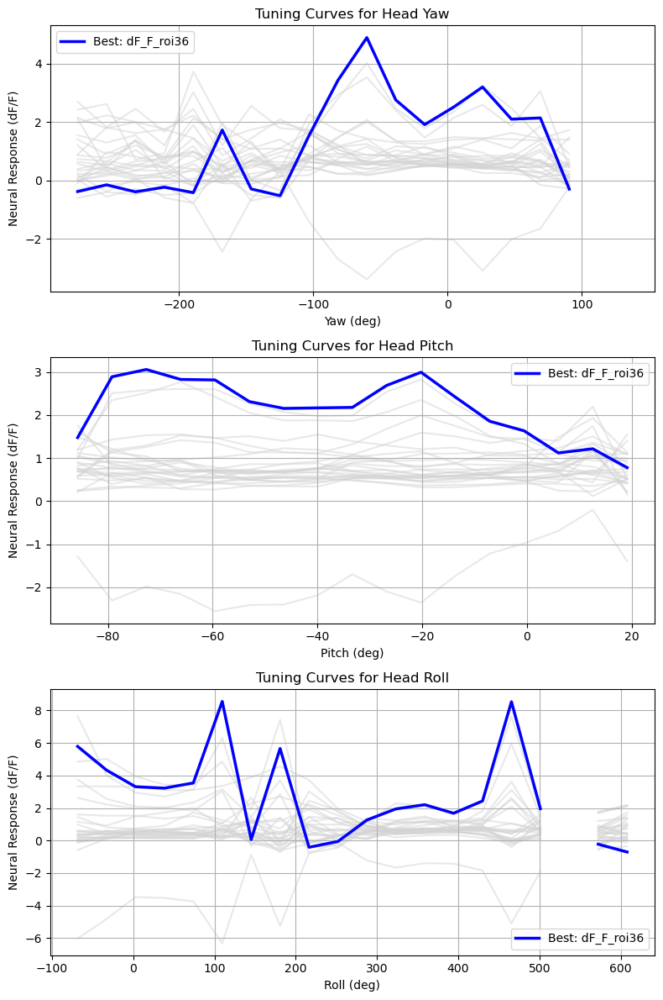

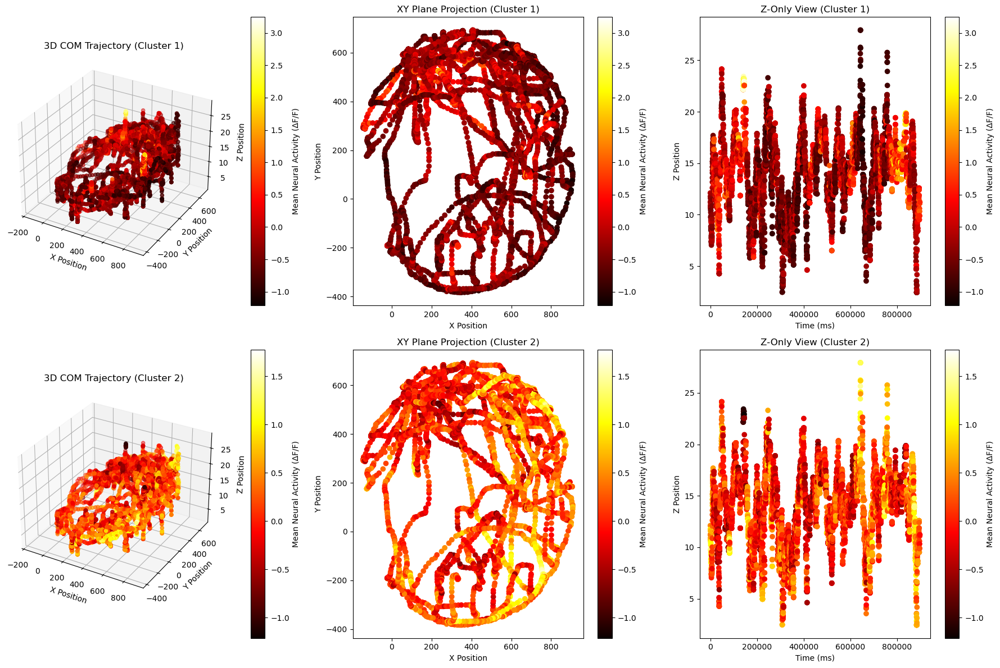


Running analysis for session: 2024_10_25_20241002PMCr2_17_05
Processing session: 2024_10_25_20241002PMCr2_17_05


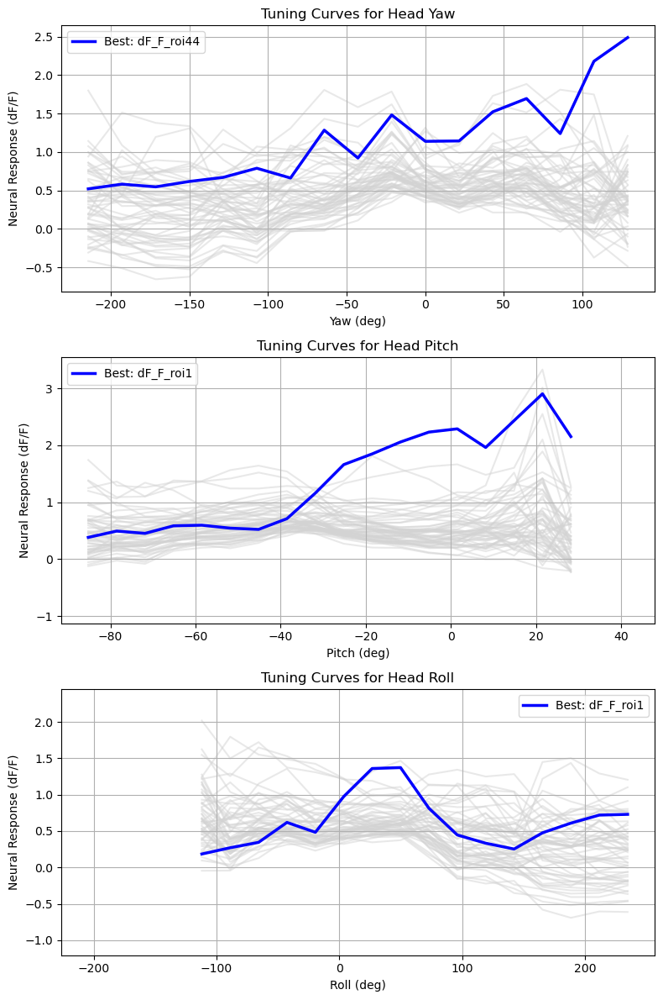

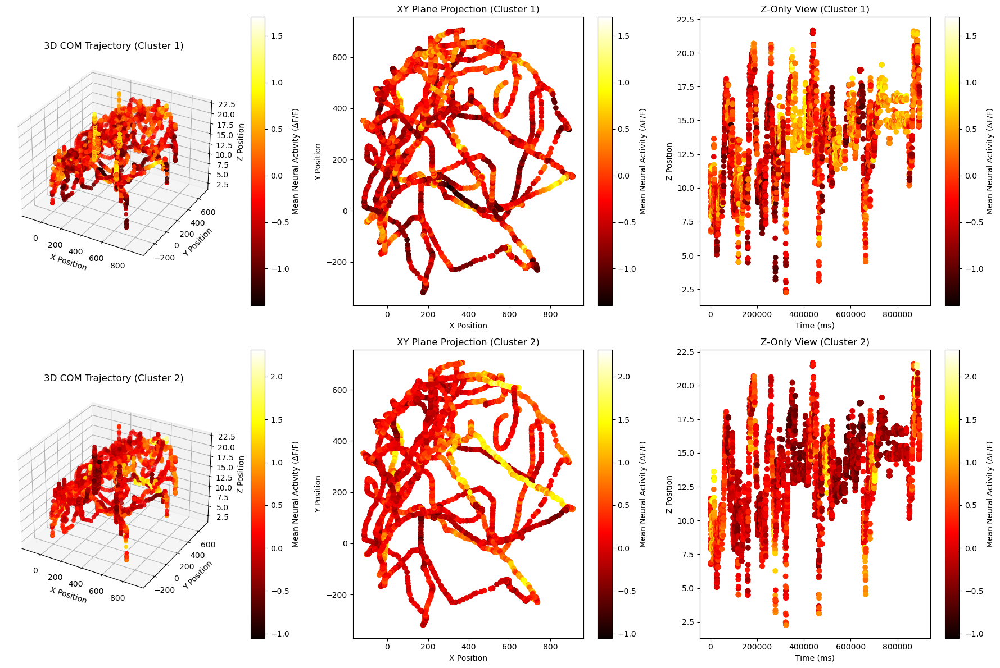


Running analysis for session: 2024_10_14_20240916v1r1_16_37
Processing session: 2024_10_14_20240916v1r1_16_37


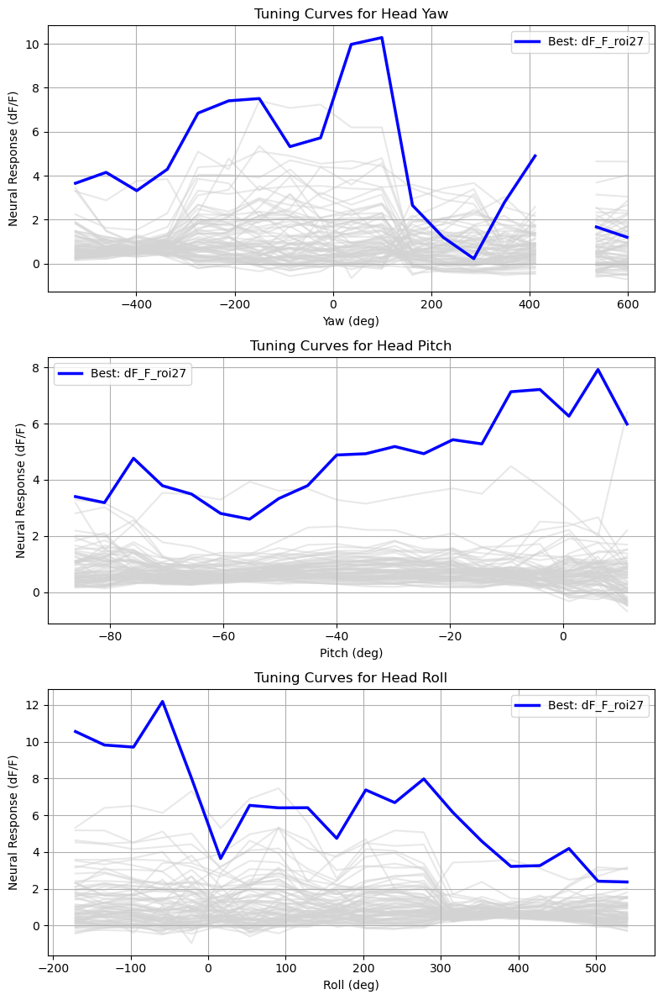

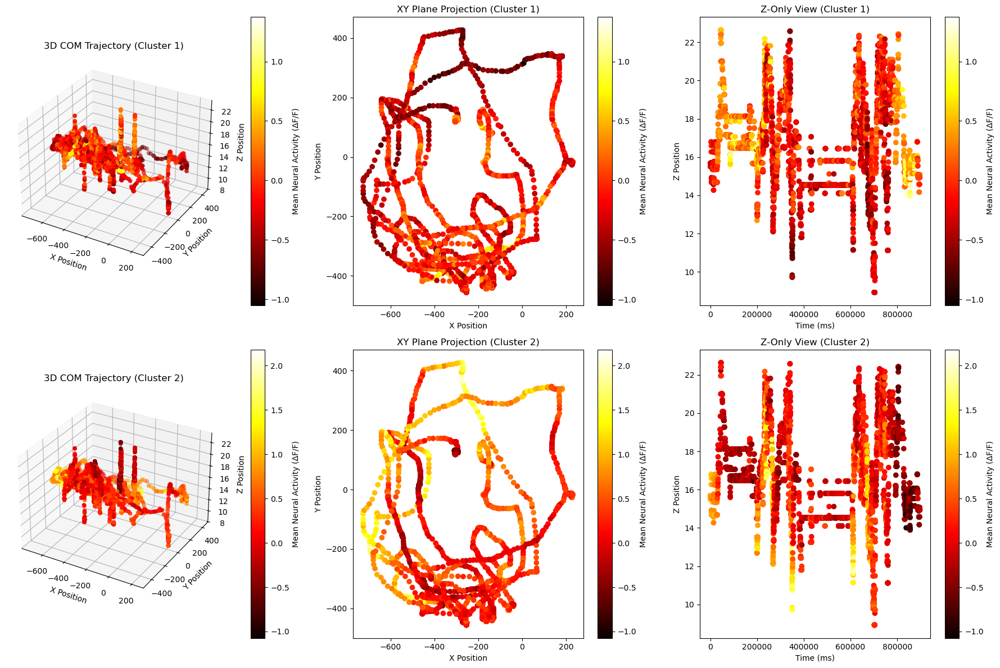


Running analysis for session: 2024_10_14_20240916v1r1_16_53
Processing session: 2024_10_14_20240916v1r1_16_53


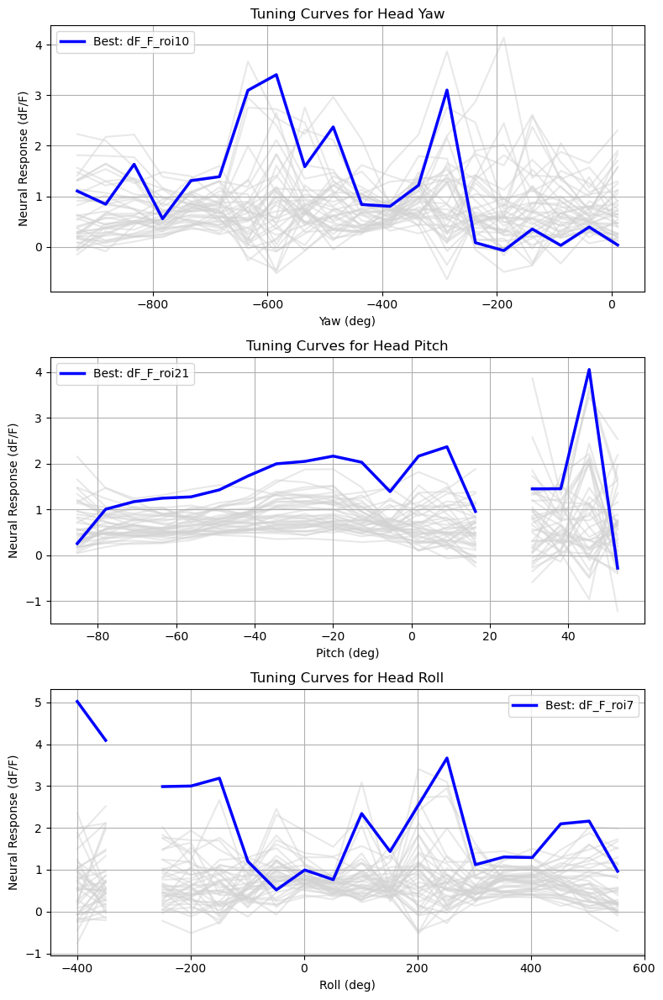

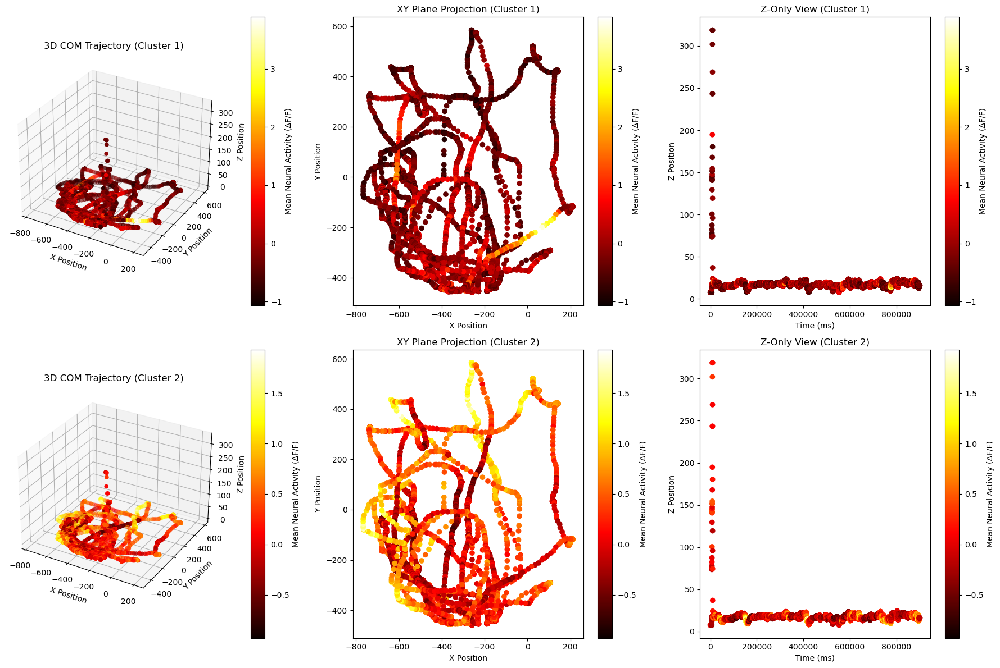


Running analysis for session: 2024_10_14_20240916v1r2_14_30
Processing session: 2024_10_14_20240916v1r2_14_30


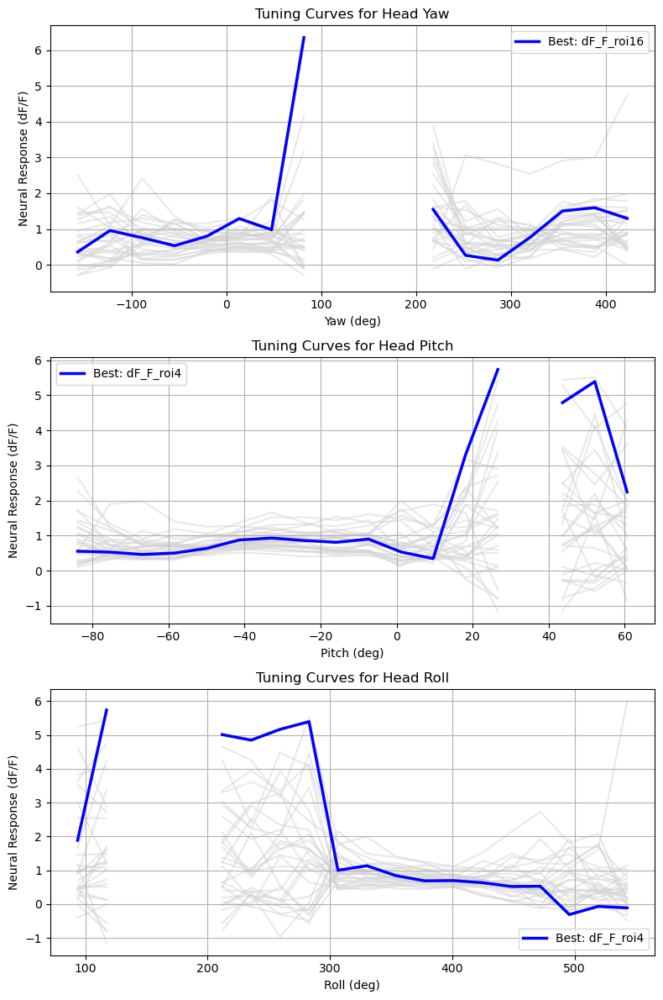

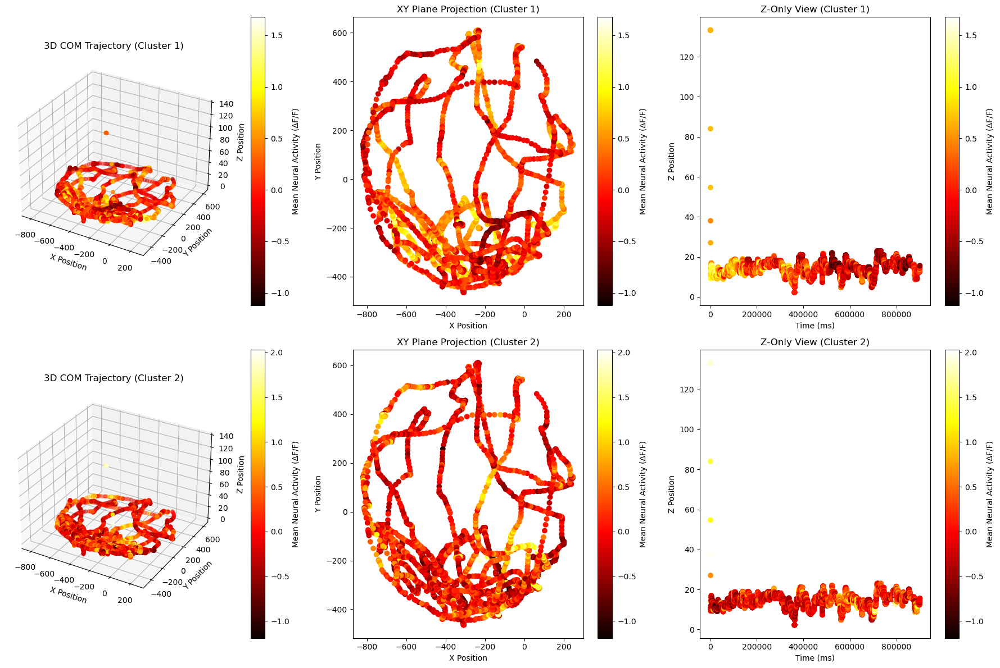


Running analysis for session: 2024_10_14_20240916v1r2_15_58
Processing session: 2024_10_14_20240916v1r2_15_58


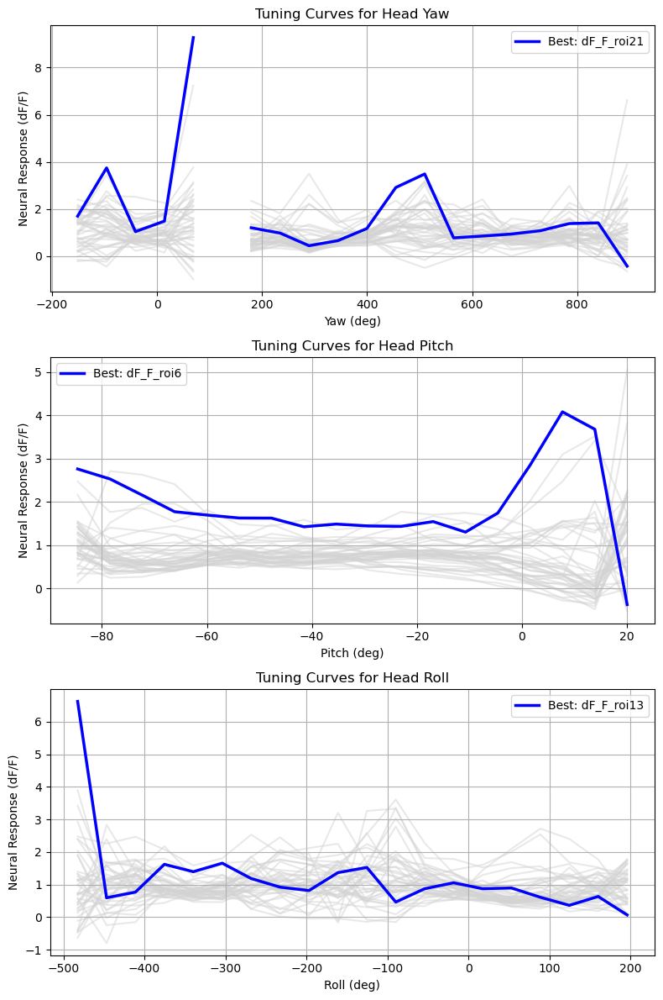

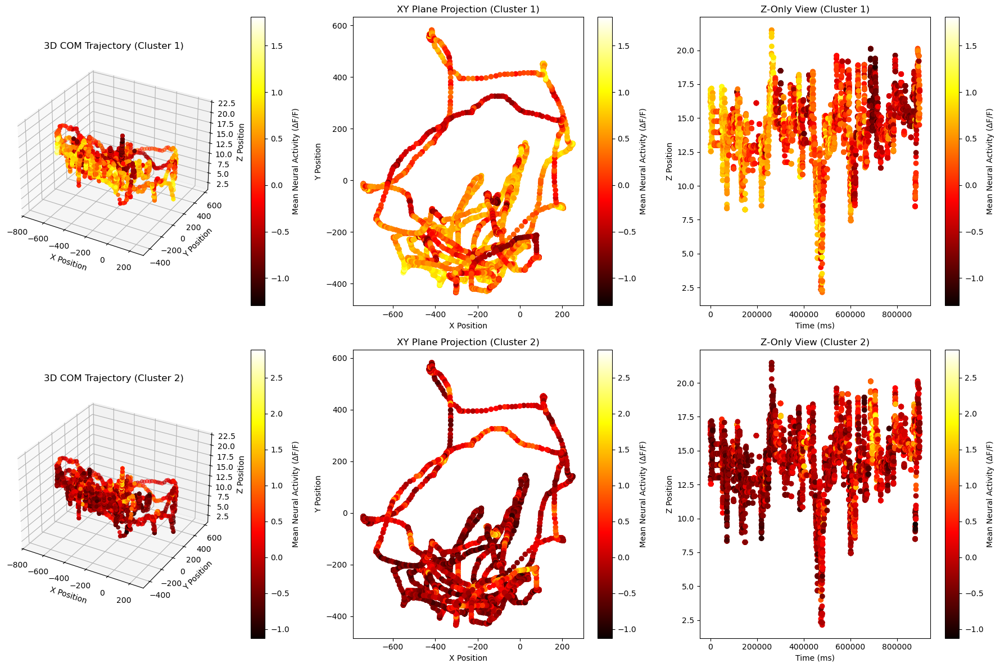


Running analysis for session: 2024_11_01_20240910V1r_AO_12_50
Processing session: 2024_11_01_20240910V1r_AO_12_50


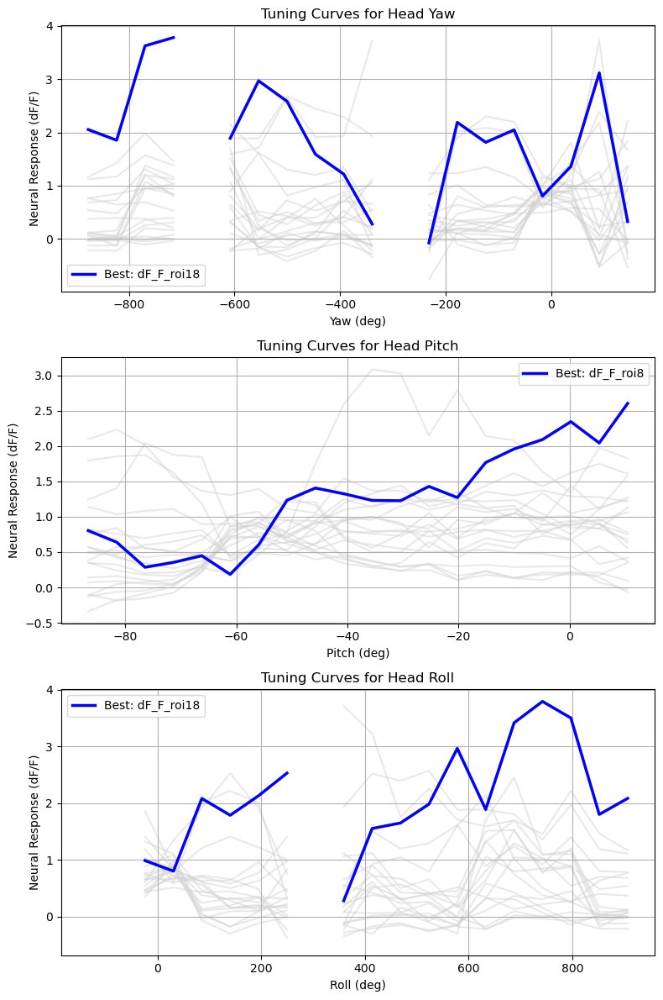

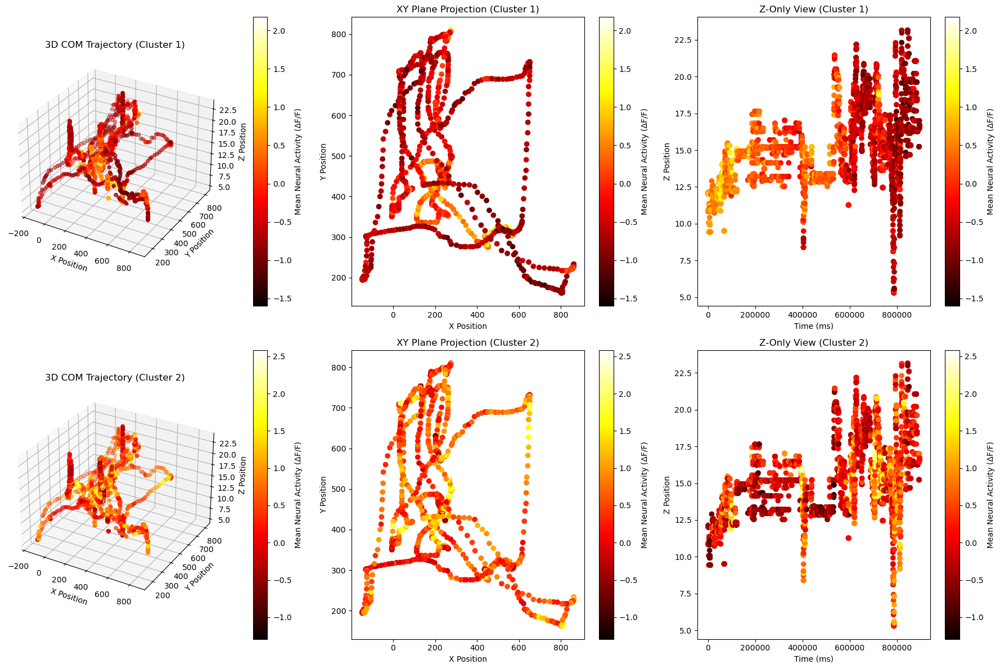


Running analysis for session: 2024_11_06_20241015pmcr2_16_53
Processing session: 2024_11_06_20241015pmcr2_16_53


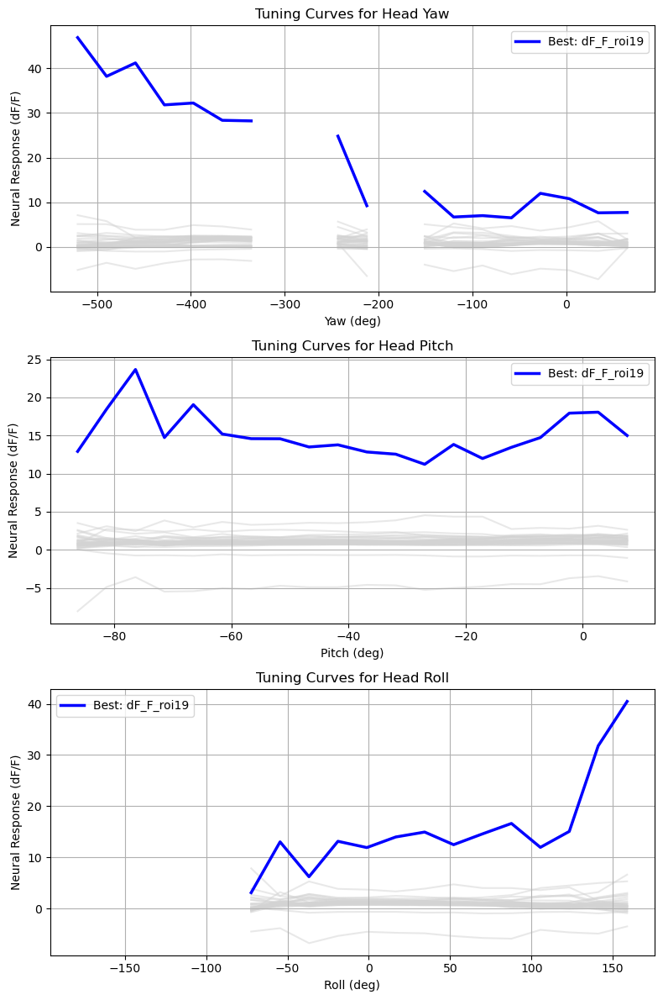

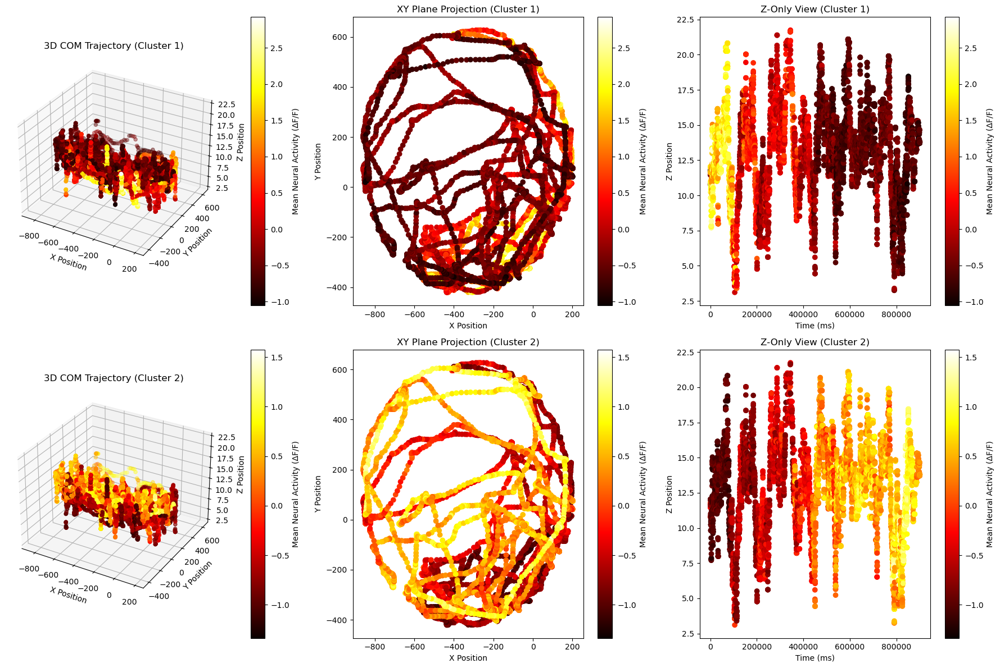

Tuning curves and clustering analysis completed.

Plotting overview for session: /data/big_rim/rsync_dcc_sum/Oct3V1/2024_10_25/20241002PMCr2_15_42


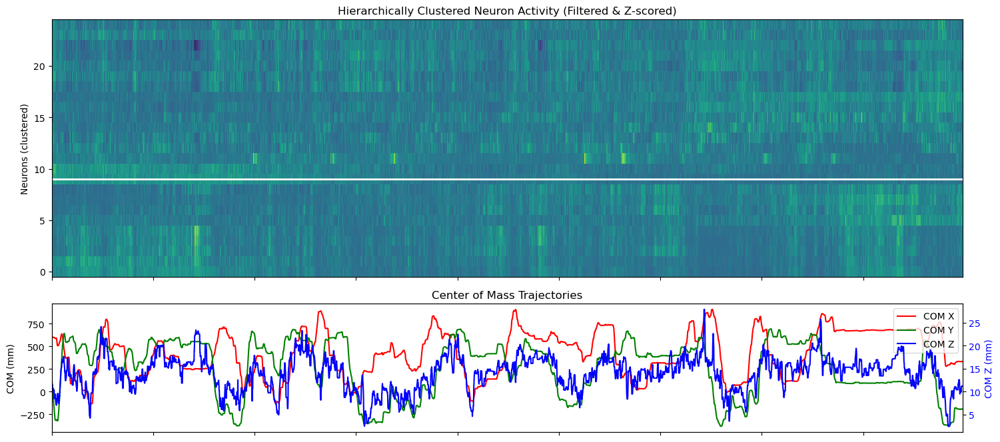


Plotting overview for session: /data/big_rim/rsync_dcc_sum/Oct3V1/2024_10_25/20241002PMCr2_17_05


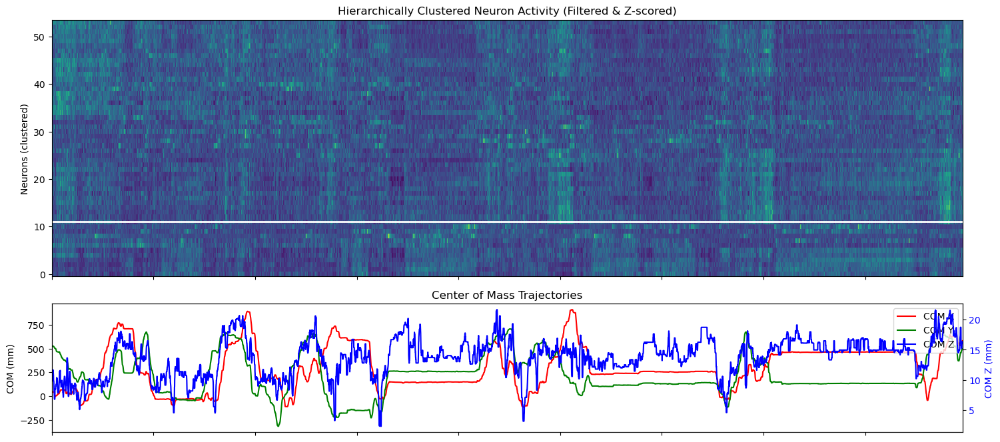


Plotting overview for session: /data/big_rim/rsync_dcc_sum/Oct3V1/2024_10_14/20240916v1r1_16_37


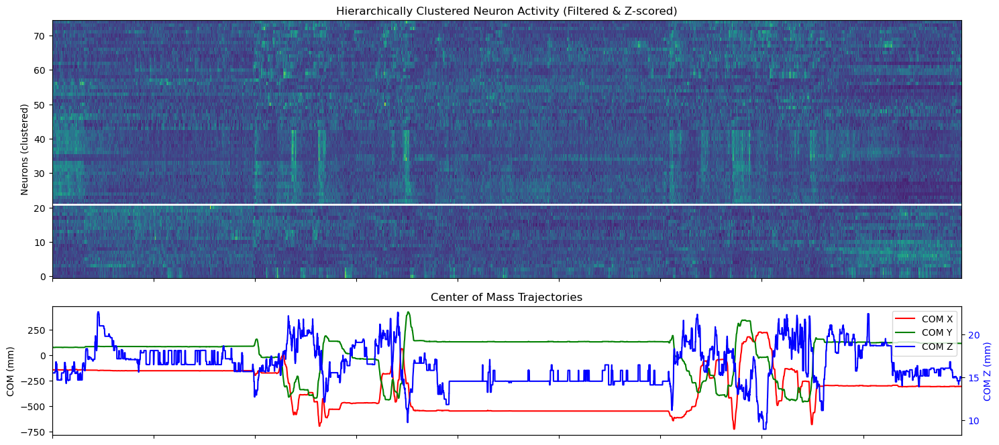


Plotting overview for session: /data/big_rim/rsync_dcc_sum/Oct3V1/2024_10_14/20240916v1r1_16_53


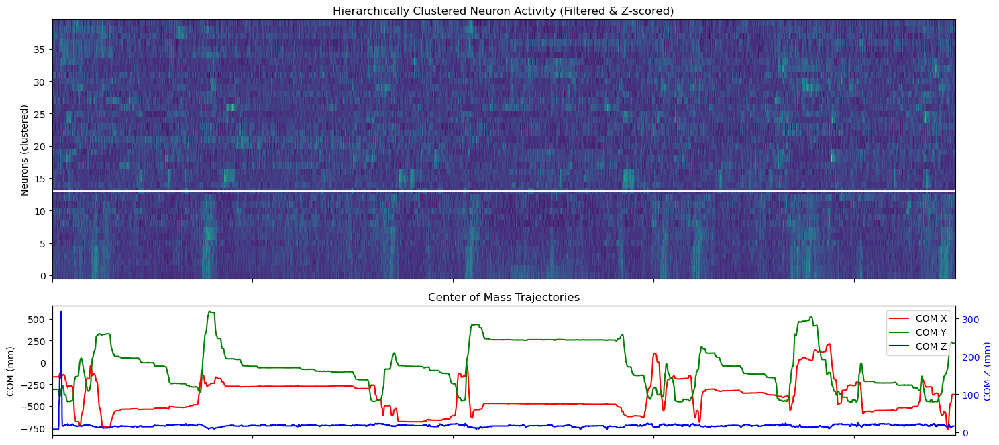


Plotting overview for session: /data/big_rim/rsync_dcc_sum/Oct3V1/2024_10_14/20240916v1r2_14_30


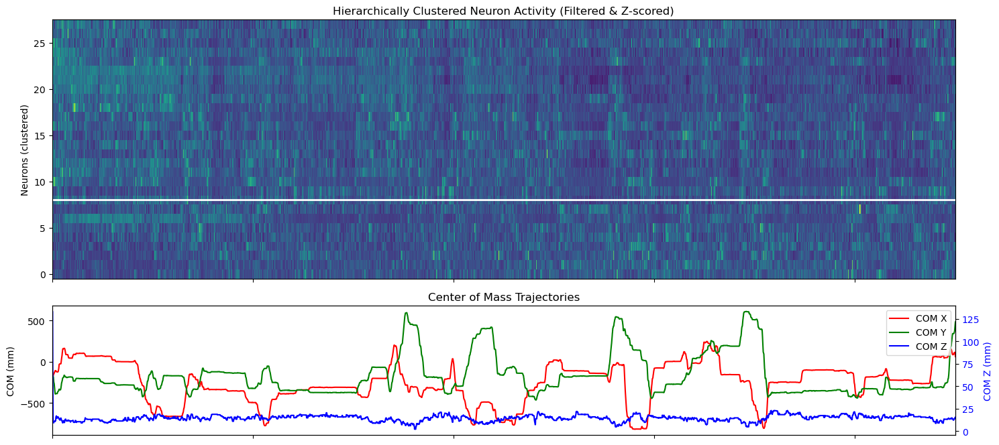


Plotting overview for session: /data/big_rim/rsync_dcc_sum/Oct3V1/2024_10_14/20240916v1r2_15_58


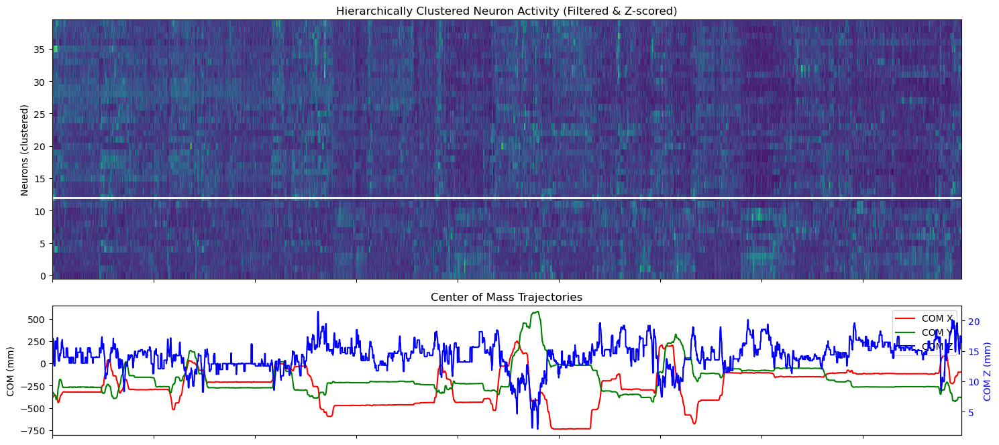


Plotting overview for session: /data/big_rim/rsync_dcc_sum/Oct3V1/2024_11_01/20240910V1r_AO_12_50


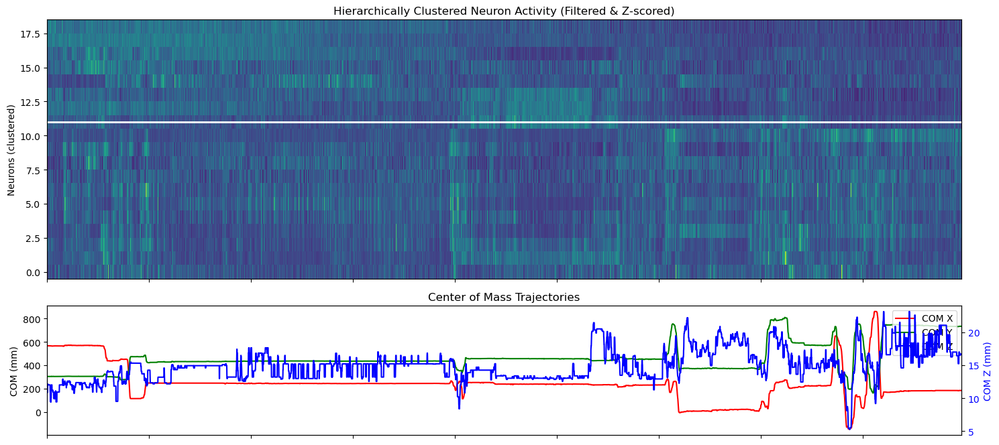


Plotting overview for session: /data/big_rim/rsync_dcc_sum/Oct3V1/2024_11_06/20241015pmcr2_16_53


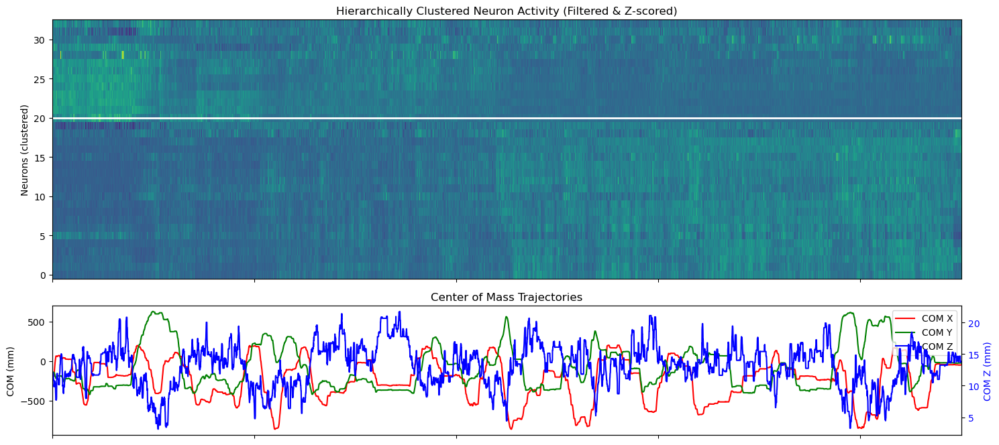

All plots generated.


In [22]:
import os
import json
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.transform import Rotation as R
from scipy.cluster.hierarchy import linkage, fcluster, leaves_list
from scipy.stats import zscore

# ============================================================================
# Part 1: Original Utility Functions for Angle Computation, Tuning Curves, etc.
# ============================================================================

def load_data(hdf5_file_path, session_id=None):
    """Load HDF5 file and attach a session_id column."""
    df = pd.read_hdf(hdf5_file_path, key='df')
    if session_id is not None:
        df['session_id'] = session_id
    return df

def normalize(v):
    norm = np.linalg.norm(v)
    return v if norm < 1e-8 else v / norm

def compute_euler_angles_from_row(row):
    """Compute head Euler angles (relative to body) for one frame."""
    def get_kp(idx):
        return np.array([row[f'kp{idx}_x'], row[f'kp{idx}_y'], row[f'kp{idx}_z']])
    
    # Head coordinate frame (EarL=1, EarR=2, Snout=3)
    earL = get_kp(1)
    earR = get_kp(2)
    snout = get_kp(3)
    ear_mid = (earL + earR) / 2.0
    head_x = normalize(snout - ear_mid)
    temp_y = earR - earL
    head_y = normalize(temp_y - np.dot(temp_y, head_x) * head_x)
    head_z = normalize(np.cross(head_x, head_y))
    
    # Body coordinate frame (SpineF=4, SpineM=5, ShoulderL=12, ShoulderR=16)
    spineF = get_kp(4)
    spineM = get_kp(5)
    shoulderL = get_kp(12)
    shoulderR = get_kp(16)
    body_x = normalize(spineF - spineM)
    shoulder_vec = shoulderR - shoulderL
    body_y = normalize(shoulder_vec - np.dot(shoulder_vec, body_x) * body_x)
    body_z = normalize(np.cross(body_x, body_y))
    
    # Compute relative rotation from body to head.
    R_body = np.column_stack((body_x, body_y, body_z))
    R_head = np.column_stack((head_x, head_y, head_z))
    R_rel = np.dot(R_body.T, R_head)
    euler_angles = R.from_matrix(R_rel).as_euler('xyz', degrees=True)
    return euler_angles

def compute_all_euler_angles(df):
    """Compute Euler angles for all frames and add them as columns to df."""
    nframes = len(df)
    yaw_vals   = np.empty(nframes)
    pitch_vals = np.empty(nframes)
    roll_vals  = np.empty(nframes)
    for i in range(nframes):
        row = df.iloc[i]
        euler = compute_euler_angles_from_row(row)
        yaw_vals[i]   = euler[0]
        pitch_vals[i] = euler[1]
        roll_vals[i]  = euler[2]
    # Unwrap angles and convert to degrees.
    yaw_vals = np.degrees(np.unwrap(np.radians(yaw_vals)))
    pitch_vals = np.degrees(np.unwrap(np.radians(pitch_vals)))
    roll_vals = np.degrees(np.unwrap(np.radians(roll_vals)))
    df['Yaw'] = yaw_vals
    df['Pitch'] = pitch_vals
    df['Roll'] = roll_vals
    return yaw_vals, pitch_vals, roll_vals

def get_neural_columns(df, prefix='dF_F_roi'):
    """Retrieve neural signal columns based on prefix."""
    return [col for col in df.columns if col.startswith(prefix)]

def exclude_neurons(df, neural_columns, exclude_indices, outlier_sigma=3):
    """
    Exclude neurons based on outlier criteria and manual indices.
    """
    # Outlier exclusion based on max activity.
    neuron_max_vals = {neuron: df[neuron].max() for neuron in neural_columns}
    max_array = np.array(list(neuron_max_vals.values()))
    mean_max = np.mean(max_array)
    std_max = np.std(max_array)
    threshold = mean_max + outlier_sigma * std_max
    outlier_neurons = [neuron for neuron, val in neuron_max_vals.items() if val > threshold]
    
    # Manual exclusion.
    manual_excluded_neurons = [f'dF_F_roi{i}' for i in exclude_indices]
    clean_neural_columns = [
        neuron for neuron in neural_columns 
        if (neuron not in outlier_neurons and neuron not in manual_excluded_neurons)
    ]
    return clean_neural_columns

def compute_tuning_curve(angle_vals, neural_vals, nbins=20):
    """
    Bin angle values and compute the mean neural response for each bin.
    """
    bins = np.linspace(np.min(angle_vals), np.max(angle_vals), nbins + 1)
    bin_centers = (bins[:-1] + bins[1:]) / 2.0
    avg_response = np.zeros(nbins)
    for i in range(nbins):
        mask = (angle_vals >= bins[i]) & (angle_vals < bins[i+1])
        avg_response[i] = np.mean(neural_vals[mask]) if np.any(mask) else np.nan
    return bin_centers, avg_response

def select_best_neuron(df, angle_vals, clean_neural_columns, nbins=20):
    """
    Select the neuron with the highest tuning curve variance for a given angle.
    """
    best_metric = -np.inf
    selected_neuron = None
    for neuron in clean_neural_columns:
        neural_vals = df[neuron].values
        _, tuning = compute_tuning_curve(angle_vals, neural_vals, nbins)
        metric = np.nanvar(tuning)
        if metric > best_metric:
            best_metric = metric
            selected_neuron = neuron
    return selected_neuron

def plot_tuning_curves(df, yaw_vals, pitch_vals, roll_vals, clean_neural_columns, best_neurons, nbins=20):
    """Plot tuning curves for Yaw, Pitch, and Roll."""
    fig, axes = plt.subplots(3, 1, figsize=(8, 12), sharex=False)
    angle_names = ['Yaw', 'Pitch', 'Roll']
    angle_vals_list = [yaw_vals, pitch_vals, roll_vals]
    
    for ax, angle_name, angle_vals in zip(axes, angle_names, angle_vals_list):
        # Plot all neurons in background.
        for neuron in clean_neural_columns:
            neural_vals = df[neuron].values
            centers, tuning = compute_tuning_curve(angle_vals, neural_vals, nbins)
            ax.plot(centers, tuning, linestyle='-', color='lightgray', alpha=0.5, zorder=1)
        
        # Highlight best neuron.
        neuron = best_neurons[angle_name]
        neural_vals = df[neuron].values
        centers, tuning = compute_tuning_curve(angle_vals, neural_vals, nbins)
        ax.plot(centers, tuning, linestyle='-', color='blue', lw=2.5, label=f'Best: {neuron}', zorder=2)
        ax.set_title(f'Tuning Curves for Head {angle_name}')
        ax.set_xlabel(f'{angle_name} (deg)')
        ax.set_ylabel('Neural Response (dF/F)')
        ax.legend()
        ax.grid(True)
    plt.tight_layout()
    plt.show()

def clustering_analysis(df, clean_neural_columns, num_clusters=2):
    """
    Cluster neurons based on their activity and plot cluster analysis views.
    """
    # Reset index without dropping so that 'timestamp_ms_mini' is preserved as a column.
    df_new = df.copy().reset_index()
    time = df_new['timestamp_ms_mini']
    neuron_activity = df_new[clean_neural_columns].values.T  # shape: (neurons, timepoints)
    
    # Drop low-variance neurons.
    neuron_variances = np.var(neuron_activity, axis=1)
    threshold = np.percentile(neuron_variances, 5)
    high_variance_indices = neuron_variances > threshold
    neuron_activity_filtered = neuron_activity[high_variance_indices, :]
    filtered_neural_columns = [col for i, col in enumerate(clean_neural_columns) if high_variance_indices[i]]
    
    # Z-score normalization.
    neuron_activity_normalized = zscore(neuron_activity_filtered, axis=1)
    Z = linkage(neuron_activity_normalized, method='average', metric='correlation')
    cluster_labels = fcluster(Z, t=num_clusters, criterion='maxclust')
    
    # Compute cluster mean activity.
    cluster_means = []
    for cluster_id in range(1, num_clusters + 1):
        cluster_neurons = neuron_activity_normalized[cluster_labels == cluster_id, :]
        cluster_mean = cluster_neurons.mean(axis=0)
        cluster_means.append(cluster_mean)
    cluster_means = np.array(cluster_means)
    
    # Plot cluster analysis results.
    fig = plt.figure(figsize=(18, 12))
    for cluster_id in range(num_clusters):
        row_offset = cluster_id * 3
        # 3D COM Trajectory.
        ax1 = fig.add_subplot(2, 3, row_offset + 1, projection='3d')
        sc1 = ax1.scatter(df_new['com_x'], df_new['com_y'], df_new['com_z'],
                          c=cluster_means[cluster_id, :len(df_new)], cmap='hot', marker='o')
        ax1.set_title(f'3D COM Trajectory (Cluster {cluster_id + 1})')
        ax1.set_xlabel('X Position')
        ax1.set_ylabel('Y Position')
        ax1.set_zlabel('Z Position')
        fig.colorbar(sc1, ax=ax1, pad=0.1, label='Mean Neural Activity (ΔF/F)')
        
        # XY Plane Projection.
        ax2 = fig.add_subplot(2, 3, row_offset + 2)
        sc2 = ax2.scatter(df_new['com_x'], df_new['com_y'],
                          c=cluster_means[cluster_id, :len(df_new)], cmap='hot', marker='o')
        ax2.set_title(f'XY Plane Projection (Cluster {cluster_id + 1})')
        ax2.set_xlabel('X Position')
        ax2.set_ylabel('Y Position')
        fig.colorbar(sc2, ax=ax2, label='Mean Neural Activity (ΔF/F)')
        
        # Z-Only View.
        ax3 = fig.add_subplot(2, 3, row_offset + 3)
        sc3 = ax3.scatter(time, df_new['com_z'],
                          c=cluster_means[cluster_id, :len(df_new)], cmap='hot', marker='o')
        ax3.set_title(f'Z-Only View (Cluster {cluster_id + 1})')
        ax3.set_xlabel('Time (ms)')
        ax3.set_ylabel('Z Position')
        fig.colorbar(sc3, ax=ax3, label='Mean Neural Activity (ΔF/F)')
    plt.tight_layout()
    plt.show()
    return cluster_labels, filtered_neural_columns

def run_single_session(session_params):
    """
    Run the analysis pipeline for a single session.
    
    session_params should be a dictionary with keys:
      - 'file_path'
      - 'session_id'
      - 'exclude_indices': list of neuron indices to exclude manually
    """
    print(f"Processing session: {session_params.get('session_id', 'unknown')}")
    # Load data.
    df = load_data(session_params['file_path'], session_id=session_params.get('session_id'))
    
    # Compute Euler angles.
    yaw_vals, pitch_vals, roll_vals = compute_all_euler_angles(df)
    
    # Retrieve and clean neural columns.
    neural_columns = get_neural_columns(df)
    clean_neural_columns = exclude_neurons(df, neural_columns, session_params.get('exclude_indices', []))
    
    # Select the best neuron for each angle.
    best_neurons = {
        'Yaw': select_best_neuron(df, yaw_vals, clean_neural_columns),
        'Pitch': select_best_neuron(df, pitch_vals, clean_neural_columns),
        'Roll': select_best_neuron(df, roll_vals, clean_neural_columns)
    }
    
    # Plot tuning curves.
    plot_tuning_curves(df, yaw_vals, pitch_vals, roll_vals, clean_neural_columns, best_neurons)
    
    # Perform clustering analysis.
    cluster_labels, filtered_neural_columns = clustering_analysis(df, clean_neural_columns)
    
    return {
        'session_id': session_params.get('session_id'),
        'best_neurons': best_neurons,
        'cluster_labels': cluster_labels,
        'filtered_neural_columns': filtered_neural_columns
    }

# ============================================================================
# Part 2: New Session Plotting Functions (Ca²⁺ Heatmap & COM Trajectories)
# ============================================================================

def load_session_data(rec_path):
    """
    Load a single session's HDF5 file, parse the folder structure to extract metadata,
    and return the resulting DataFrame with added metadata columns.
    
    Expected folder structure:
      {base_path}/{recording_date}/{session_id}
      
    For example:
      /data/big_rim/rsync_dcc_sum/Oct3V1/2024_10_25/20241002PMCr2_15_42

    Extracted metadata:
      - session_id    = 20241002PMCr2_15_42  (last directory)
      - recording_date = 2024_10_25          (parent directory)
      - experiment    = Oct3V1              (grandparent directory)
    """
    hdf5_file_path = os.path.join(rec_path, 'MIR_Aligned', 'aligned_predictions_with_ca_and_dF_F.h5')
    df = pd.read_hdf(hdf5_file_path, key='df')
    
    norm_path = os.path.normpath(rec_path)
    session_id = os.path.basename(norm_path)
    recording_date = os.path.basename(os.path.dirname(norm_path))
    experiment_name = os.path.basename(os.path.dirname(os.path.dirname(norm_path)))
    
    df['session_id'] = session_id
    df['recording_date'] = recording_date
    df['experiment'] = experiment_name
    df['session_path'] = rec_path
    df['file_path'] = hdf5_file_path
    
    return df

def process_neuron_activity(df, exclude_dict=None, manual_exclude_indices=None, apply_exclusion=True):
    """
    Process neuron activity data:
      - Optionally exclude specific neurons.
      - Remove low-variance neurons.
      - Z-score normalize each neuron's time course.
    
    Returns:
      - neuron_activity_normalized: np.array of shape (neurons, timepoints)
      - filtered_neuron_columns: list of neuron column names after filtering
      - df_new: DataFrame with reset index (should contain timestamp info)
    """
    if apply_exclusion:
        if manual_exclude_indices is not None:
            excluded_indices = manual_exclude_indices
        elif exclude_dict is not None:
            session_path = df['session_path'].iloc[0]
            excluded_indices = get_excluded_neurons_for_session(session_path, exclude_dict)
        else:
            excluded_indices = []
    else:
        excluded_indices = []
    
    manual_excluded_neurons = [f'dF_F_roi{i}' for i in excluded_indices]
    
    neuron_columns = [
        col for col in df.columns 
        if col.startswith('dF_F_roi') and col not in manual_excluded_neurons
    ]
    
    neuron_activity = df[neuron_columns].values.T
    neuron_variances = np.var(neuron_activity, axis=1)
    threshold = np.percentile(neuron_variances, 5)
    high_variance_indices = neuron_variances > threshold
    neuron_activity_filtered = neuron_activity[high_variance_indices, :]
    filtered_neuron_columns = [col for i, col in enumerate(neuron_columns) if high_variance_indices[i]]
    
    neuron_activity_normalized = zscore(neuron_activity_filtered, axis=1)
    df_new = df.reset_index()
    
    return neuron_activity_normalized, filtered_neuron_columns, df_new

def plot_session_data(df, exclude_dict=None, manual_exclude_indices=None, apply_exclusion=True):
    """
    Produce a figure with:
      - A Ca²⁺ heatmap of hierarchically clustered neuron activity with cluster boundaries.
      - Center of mass (COM) trajectories.
    
    Expects the DataFrame to have a 'timestamp_ms_mini' column for the x-axis.
    """
    neuron_activity_normalized, filtered_neuron_columns, df_new = process_neuron_activity(
        df, exclude_dict=exclude_dict, manual_exclude_indices=manual_exclude_indices, apply_exclusion=apply_exclusion
    )
    time = df_new['timestamp_ms_mini']
    
    fig = plt.figure(figsize=(15, 10))
    gs = fig.add_gridspec(nrows=3, ncols=1, height_ratios=[2, 1, 1.5])
    
    # --- Plot 1: Ca²⁺ Heatmap with Cluster Boundaries ---
    ax1 = fig.add_subplot(gs[0, 0])
    if neuron_activity_normalized is not None and filtered_neuron_columns is not None:
        Z = linkage(neuron_activity_normalized, method='ward')
        neuron_order = leaves_list(Z)
        neuron_activity_ordered = neuron_activity_normalized[neuron_order, :]
        ordered_neuron_columns = [filtered_neuron_columns[i] for i in neuron_order]
        
        num_clusters = 2  # adjust if needed
        cluster_labels = fcluster(Z, t=num_clusters, criterion='maxclust')
        cluster_labels_ordered = cluster_labels[neuron_order]
        
        neuron_indices = np.arange(len(neuron_activity_ordered))
        mesh = ax1.pcolormesh(
            time, neuron_indices, neuron_activity_ordered,
            cmap='viridis', shading='auto'
        )
        ax1.set_title('Hierarchically Clustered Neuron Activity (Filtered & Z-scored)')
        ax1.set_ylabel('Neurons (clustered)')
        
        boundaries = []
        for i in range(1, len(cluster_labels_ordered)):
            if cluster_labels_ordered[i] != cluster_labels_ordered[i - 1]:
                boundaries.append(i)
        for b in boundaries:
            ax1.axhline(b, color='white', linewidth=2)
    else:
        print("Neuron activity data not found. Skipping heatmap plot.")
        ax1.text(0.5, 0.5, 'No neuron activity data available.',
                 transform=ax1.transAxes, ha='center', va='center')
        ax1.set_title('No Neuron Activity Plot')
    ax1.tick_params(labelbottom=False)
    
    # --- Plot 2: Center of Mass (COM) Trajectories ---
    ax2 = fig.add_subplot(gs[1, 0], sharex=ax1)
    if {'com_x', 'com_y', 'com_z'}.issubset(df_new.columns):
        ax2.plot(time, df_new['com_x'], color='red', label='COM X')
        ax2.plot(time, df_new['com_y'], color='green', label='COM Y')
        ax2.set_ylabel('COM (mm)')
        ax2.set_title('Center of Mass Trajectories')
        
        ax2_right = ax2.twinx()
        ax2_right.plot(time, df_new['com_z'], color='blue', label='COM Z')
        ax2_right.set_ylabel('COM Z (mm)', color='blue')
        ax2_right.tick_params(axis='y', labelcolor='blue')
        
        lines_ax2, labels_ax2 = ax2.get_legend_handles_labels()
        lines_ax2_right, labels_ax2_right = ax2_right.get_legend_handles_labels()
        ax2.legend(lines_ax2 + lines_ax2_right, labels_ax2 + labels_ax2_right, loc='upper right')
    else:
        print("COM columns not found (com_x, com_y, com_z). Check your DataFrame.")
    ax2.tick_params(labelbottom=False)
    
    plt.tight_layout()
    plt.show()

# ============================================================================
# Part 3: Main Block – Run All Plots for Each Recording
# ============================================================================

if __name__ == '__main__':
    # Define the base path and relative session paths.
    base_path = "/data/big_rim/rsync_dcc_sum/Oct3V1"
    recordings = [
        '2024_10_25/20241002PMCr2_15_42',
        '2024_10_25/20241002PMCr2_17_05',
        '2024_10_14/20240916v1r1_16_37',
        '2024_10_14/20240916v1r1_16_53',
        '2024_10_14/20240916v1r2_14_30',
        '2024_10_14/20240916v1r2_15_58',
        '2024_11_01/20240910V1r_AO_12_50',
        '2024_11_06/20241015pmcr2_16_53'
    ]
    
    # Run both pipelines for each recording.
    # Pipeline A: Tuning Curves and Clustering Analysis (using run_single_session)
    # Pipeline B: Session Overview Plot (Ca²⁺ heatmap & COM trajectories)
    # You can choose to run one or both.
    
    # First, run the tuning curves & clustering analysis pipeline.
    results = []
    # Note: In this pipeline we use the original load_data.
    for rec in recordings:
        session_dir = os.path.join(base_path, rec)
        file_path = os.path.join(session_dir, 'MIR_Aligned', 'aligned_predictions_with_ca_and_dF_F.h5')
        session_id = rec.replace("/", "_")
        # Get exclusion from JSON if available.
        exclude_file = "/home/lq53/mir_repos/BBOP/random_tests/25feb_more_corr_explo/neuro_exclude.json"
        with open(exclude_file, "r") as f:
            exclude_dict = json.load(f)
        exclude_indices = exclude_dict.get(session_dir, [])
        
        session_params = {
            'file_path': file_path,
            'session_id': session_id,
            'exclude_indices': exclude_indices
        }
        print(f"\nRunning analysis for session: {session_id}")
        res = run_single_session(session_params)
        results.append(res)
    
    print("Tuning curves and clustering analysis completed.")
    
    # Next, run the session overview plotting pipeline.
    # Here we use load_session_data (which adds metadata) and plot_session_data.
    for rec in recordings:
        session_path = os.path.join(base_path, rec)
        print(f"\nPlotting overview for session: {session_path}")
        df_session = load_session_data(session_path)
        # Plot the Ca²⁺ heatmap (with cluster boundaries) and COM trajectories.
        plot_session_data(df_session, exclude_dict=exclude_dict, apply_exclusion=True)
    
    print("All plots generated.")
